<a href="https://colab.research.google.com/github/eric6450/2023-scEpieQTL-summer/blob/main/scEpi_eQTL_PBMC2_0_0_scRNAanno_0830.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!pip install jedi

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 7.6 MB/s eta 0:00:00


In [ ]:
!pip install scvi-colab
from scvi_colab import install

In [ ]:
#default
#install()

# from a GitHub branch
install(branch="0.14.x")

# A specific PyPI version
#install(version="0.15.1")

INFO     scvi-colab: Installing scvi-tools.                                                                        
INFO     scvi-colab: Install successful. Testing import.                                                           


/usr/local/lib/python3.10/dist-packages/scvi/_settings.py:63: UserWarning: Since v1.0.0, scvi-tools no longer uses a random seed by default. Run `scvi.settings.seed = 0` to reproduce results from previous versions.
  self.seed = seed
/usr/local/lib/python3.10/dist-packages/scvi/_settings.py:70: UserWarning: Setting `dl_pin_memory_gpu_training` is deprecated in v1.0 and will be removed in v1.1. Please pass in `pin_memory` to the data loaders instead.
  self.dl_pin_memory_gpu_training = (


In [ ]:
!pip install muon

#To use a pre-release version of muon, install it from from the GitHub repository:
#!pip install git+https://github.com/gtca/muon

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 292.7/292.7 kB 3.4 MB/s eta 0:00:00


In [ ]:
!pip install pysam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.0/20.0 MB 15.1 MB/s eta 0:00:00


In [ ]:
import os
#import h5py
#import scipy
#import seaborn as sns
import anndata as ad
import numpy as np
import scanpy as sc
import pandas as pd
import muon as mu
from muon import MuData
# Import a module with ATAC-seq-related functions
from muon import atac as ac
#from sklearn.preprocessing import StandardScaler
#from sklearn.preprocessing import MinMaxScaler
import scvi; print(scvi.__version__)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
sc.set_figure_params(dpi=100, figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2
sc.settings.max_memory=5
sc.settings.autoshow=False
#sc.settings.ScanpyConfig(autoshow=False,max_memory=4)

1.0.3


In [ ]:
'''
#@title PBMC10k 1.0.0
!mkdir data
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv
!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi
!mkdir write
'''

'\n#@title PBMC10k 1.0.0\n!mkdir data\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv\n!wget https://cf.10xgenomics.com/samples/cell-arc/1.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi\n!mkdir write\n'

In [ ]:
#@title PBMC10k 2.0.0
!mkdir data
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5 -O data/pbmc10k_filtered_feature_bc_matrix.h5
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed -O data/peaks.bed
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz -O data/atac_fragments.tsv.gz
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peak_annotation.tsv -O data/atac_peak_annotation.tsv
!wget https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_fragments.tsv.gz.tbi -O data/atac_fragments.tsv.gz.tbi
!mkdir write

--2023-08-28 12:41:17--  https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_filtered_feature_bc_matrix.h5
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:1ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 192125528 (183M) [binary/octet-stream]
Saving to: ‘data/pbmc10k_filtered_feature_bc_matrix.h5’

data/pbmc10k_filter 100%[===================>] 183.22M   110MB/s    in 1.7s    

2023-08-28 12:41:19 (110 MB/s) - ‘data/pbmc10k_filtered_feature_bc_matrix.h5’ saved [192125528/192125528]

--2023-08-28 12:41:19--  https://cf.10xgenomics.com/samples/cell-arc/2.0.0/pbmc_granulocyte_sorted_10k/pbmc_granulocyte_sorted_10k_atac_peaks.bed
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:1ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|10

In [ ]:
results_file = 'write/pbmc10k.h5ad'  # the file that will store the analysis results

In [ ]:
peak = pd.read_csv('data/peaks.bed', sep='\t', names=['chr','start','end'], comment="#")
peak

,chr,start,end
0,chr1,9790,10675
1,chr1,180599,181702
2,chr1,191168,192093
3,chr1,267565,268455
4,chr1,270876,271770
...,...,...,...
143882,KI270713.1,21434,22340
143883,KI270713.1,26201,26826
143884,KI270713.1,29624,30457
143885,KI270713.1,31340,32243


In [ ]:
mdata = mu.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5') #, gex_only=False)

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Added `interval` annotation for features from /content/data/pbmc10k_filtered_feature_bc_matrix.h5


/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/usr/local/lib/python3.10/dist-packages/mudata/_core/mudata.py:479: UserWarning: var_names are not unique. To make them unique, call `.var_names_make_unique`.
  warnings.warn(


Added peak annotation from /content/data/atac_peak_annotation.tsv to .uns['atac']['peak_annotation']
Added gene names to peak annotation in .uns['atac']['peak_annotation']
Located fragments file: /content/data/atac_fragments.tsv.gz


In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
    atac:	11898 x 143887
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
      uns:	'atac', 'files'

In [ ]:
mdata.mod['atac'].uns

OrderedDict([('atac',
              {'peak_annotation':                                peak  distance peak_type
               gene_name                                              
               MIR1302-2HG         chr1:9790-10675    -18879    distal
               AL627309.5       chr1:180599-181702     -6738    distal
               AL627309.5       chr1:191168-192093    -17307    distal
               AP006222.2       chr1:267565-268455       711    distal
               AP006222.2       chr1:270876-271770      4022    distal
               ...                             ...       ...       ...
               AC213203.2   KI270713.1:21434-22340     10188    distal
               AC213203.2   KI270713.1:26201-26826      5702    distal
               AC213203.2   KI270713.1:29624-30457      2071    distal
               AC213203.2   KI270713.1:31340-32243       285    distal
               AC213203.1   KI270713.1:36927-37836      1521    distal
               
               [1832

In [ ]:
mdata.var_names_make_unique()
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
    atac:	11898 x 143887
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
      uns:	'atac', 'files'

In [ ]:
#ad = sc.read_10x_h5('/content/data/pbmc10k_filtered_feature_bc_matrix.h5', gex_only=False)
#ad

In [ ]:
ad_rna = mdata.mod['rna']
ad_atac = mdata.mod['atac']
#rna

In [ ]:
#ad_rna = ad[:, ad.var['feature_types']=='Gene Expression']
#ad_atac = ad[:, ad.var['feature_types']=='Peaks']

In [ ]:
ad_rna

AnnData object with n_obs × n_vars = 11898 × 36601
    var: 'gene_ids', 'feature_types', 'genome', 'interval'

In [ ]:
ad_atac

AnnData object with n_obs × n_vars = 11898 × 143887
    var: 'gene_ids', 'feature_types', 'genome', 'interval'
    uns: 'atac', 'files'

## 讀入Gene ID

In [ ]:
all762eqtl_ID=np.load('/content/drive/MyDrive/scEpieQTL/all762eqtl_ID.npy') #沒有附gene的eQTL

In [ ]:
all762eqtl_ID.shape

(786,)

In [ ]:
#all762eqtl_ID

In [ ]:
all762eqtl_geneID=np.load('/content/drive/MyDrive/scEpieQTL/786_peak_id_gene_name.npy') #有附gene的eQTL

In [ ]:
all762eqtl_geneID.shape

(786,)

In [ ]:
#all762eqtl_geneID #有附gene的eQTL

In [ ]:
#eqtl368_geneID0719=np.load('/content/drive/MyDrive/scEpieQTL/all_368eqtlID_gane_name.npy') #0719找出的368個eQTL
#eqtl125_geneID0813=np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_gexdiff0813ID.npy') # 0812->125 eqtl target gene express difference的eqtl ID順序(atac改變使用文策的分群方式判斷
eqtl125_geneID0815=np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_newmodelgexdiff0815ID.npy') #0815->125 eqtl target gene express difference ID(修改過model的訓練集問題)

In [ ]:
eqtl125_geneID0815.shape

(125,)

In [ ]:
#eqtl125_geneID0815

## 讀入預測的gene expression(差值:alt-ref)
找出標準差

做Normalize

存到obs中

In [ ]:
#all368eqtl_gexdiff0721=np.load('/content/drive/MyDrive/scEpieQTL/基因表現差值的all_368eqtl_gexdiff0721.npy') #基因表現差值的368x11898 npy檔
#all_125eqtl_gexdiff0813=np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_gexdiff0813.npy') #
all_125eqtl_gexdiff0815=np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_newmodelgexdiff0815.npy')

In [ ]:
all_125eqtl_gexdiff0815.shape

(125, 11898)

In [ ]:
#all_125eqtl_gexdiff0815

In [ ]:
# 每一列除以该列的最大绝对值
max_abs_vals = np.max(np.abs(all_125eqtl_gexdiff0815.T), axis=0) # 将行和列交换，使用numpy.transpose()方法或是.T
normalized_data = all_125eqtl_gexdiff0815.T / max_abs_vals

In [ ]:
#max_abs_vals

In [ ]:
normalized_data.shape

(11898, 125)

In [ ]:
all_125eqtl_gexdiff0815=normalized_data.T

In [ ]:
all_125eqtl_gexdiff0815.shape

(125, 11898)

In [ ]:
#all_125eqtl_gexdiff0815

In [ ]:
for i in range(0,125):
  #ad_rna.obs[f"all368eqtl_gexdiff0721_{i:d}"] = pd.Categorical(all368eqtl_gexdiff0721[i,:])
  ad_rna.obs[f"all_125eqtl_gexdiff0815_{i:d}"] = all_125eqtl_gexdiff0815[i,:]
  ad_atac.obs[f"all_125eqtl_gexdiff0815_{i:d}"] = all_125eqtl_gexdiff0815[i,:]

<ipython-input-41-f97734653927>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"all_125eqtl_gexdiff0815_{i:d}"] = all_125eqtl_gexdiff0815[i,:]
<ipython-input-41-f97734653927>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"all_125eqtl_gexdiff0815_{i:d}"] = all_125eqtl_gexdiff0815[i,:]
<ipython-input-41-f97734653927>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once 

In [ ]:
all125eqtl_gexdiff = pd.DataFrame(np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_newmodelgexdiff0815.npy'))

In [ ]:
all125eqtl_gexdiff.T.describe()

,0,1,2,3,4,5,6,7,8,9,...,115,116,117,118,119,120,121,122,123,124
count,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,...,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000
mean,0.000161,-0.000001,0.000499,0.000462,0.000221,0.001709,-0.000474,-0.000298,0.000382,-0.000136,...,0.000904,0.005446,0.000176,-0.000128,-0.000159,0.002976,0.000476,-0.001190,0.000026,0.000055
std,0.003199,0.002151,0.004571,0.004995,0.003550,0.007759,0.004553,0.004382,0.003615,0.001725,...,0.010792,0.034472,0.004122,0.005097,0.006832,0.009952,0.004258,0.005665,0.002472,0.003730
min,-0.028193,-0.032067,-0.031768,-0.054663,-0.033683,-0.053366,-0.078764,-0.056617,-0.024830,-0.022440,...,-0.074232,-0.266406,-0.045308,-0.065755,-0.061025,-0.075089,-0.047009,-0.042256,-0.030329,-0.028335
25%,0.000000,0.000000,-0.000503,0.000000,0.000000,0.000000,0.000000,0.000000,-0.000376,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-0.003345,0.000000,-0.000481
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.001507,0.000000,0.000000,0.001868,0.000000,0.000000,0.001363,0.000000,...,0.001231,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000003,0.000000,0.000460
max,0.036387,0.023955,0.037595,0.060384,0.034360,0.061464,0.040109,0.065633,0.029642,0.022242,...,0.092060,0.605715,0.037712,0.065333,0.094041,0.141779,0.036174,0.046838,0.042093,0.029084


In [ ]:
all125eqtl_gexdiff_std = all125eqtl_gexdiff.T.describe().loc['std']

In [ ]:
all125eqtl_gexdiff_std

0      0.003199
1      0.002151
2      0.004571
3      0.004995
4      0.003550
         ...   
120    0.009952
121    0.004258
122    0.005665
123    0.002472
124    0.003730
Name: std, Length: 125, dtype: float64

## 載入eQTL檔案  ##

In [ ]:
# 文策提供的125 eqtl 分群 cluster0-5 2023/08/3
# 讀取CSV文件並儲存為DataFrame
data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0803.csv')

# 文策提供的125 eqtl 分群 cluster0-5 2023/08/1
# 讀取CSV文件並儲存為DataFrame
#data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0801.csv')

# 文策提供的125 eqtl 分群 cluster0-3 2023/07/27
# 讀取CSV文件並儲存為DataFrame
#data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.csv')

# 去掉索引列，使用reset_index()方法，并指定drop=True
#data_frame = data_frame.reset_index(drop=True)

#指定要读取的列，去掉第一欄
data_frame.drop('Unnamed: 0', axis=1, inplace=True)

# 将行和列交换，使用transpose()方法
data_frame_transposed = data_frame.transpose()

# 将DataFrame转换为NumPy数组
data_array = data_frame_transposed.to_numpy()

# 在google drive儲存NumPy array為.npy檔
#np.save('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.npy', data_array)

In [ ]:
#top125_eqtl=np.load('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels.npy',allow_pickle=True)
top125_eqtl=data_array

In [ ]:
top125_eqtl.shape

(125, 11898)

In [ ]:
top125_eqtl

array([[1, 1, 1, ..., 2, 1, 1],
       [0, 0, 0, ..., 0, 0, 0],
       [2, 2, 2, ..., 2, 2, 2],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 1, 0, 0],
       [1, 0, 1, ..., 0, 0, 0]])

In [ ]:
for i in range(0,125):
  ad_rna.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
  ad_atac.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])

<ipython-input-50-35ee84f5a783>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
<ipython-input-50-35ee84f5a783>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"top125_eqtl_{i:d}"] = pd.Categorical(top125_eqtl[i,:])
<ipython-input-50-35ee84f5a783>:2: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(

In [ ]:
top125_eqtl_ID=data_frame_transposed.index.to_numpy()

In [ ]:
#top125_eqtl_ID

## 附上ID的 scBasset predicition 存成 pandas df
 讀取
df =  pd.read_pickle('whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')

 讀取完的 dataframe index 為 對應序列 ID

 因為有 REF 和 ALT 所以會每兩行 index 一樣

 順序是先 REF 再 ALT


 可以轉成 numpy array

arr = from_df.to_numpy()

In [ ]:
dfsb=pd.read_pickle('/content/drive/MyDrive/scEpieQTL/whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')

In [ ]:
dfsb.T.describe()

,positive_chr10_49194771_A_C_b38,positive_chr10_49194771_A_C_b38,positive_chr10_80535642_G_A_b38,positive_chr10_80535642_G_A_b38,positive_chr19_57500079_C_T_b38,positive_chr19_57500079_C_T_b38,positive_chr8_30812874_G_T_b38,positive_chr8_30812874_G_T_b38,positive_chr1_16678275_G_T_b38,positive_chr1_16678275_G_T_b38,...,positive_chr3_197509972_C_G_b38,positive_chr3_197509972_C_G_b38,positive_chr16_57185867_C_G_b38,positive_chr16_57185867_C_G_b38,positive_chr19_51407725_T_C_b38,positive_chr19_51407725_T_C_b38,positive_chr10_45727041_C_G_b38,positive_chr10_45727041_C_G_b38,positive_chr10_75381106_A_G_b38,positive_chr10_75381106_A_G_b38
count,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,...,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000,11898.000000
mean,0.228540,0.228998,0.556156,0.555438,0.670201,0.667473,0.518468,0.541848,0.213662,0.273210,...,0.184711,0.185912,0.919561,0.917301,0.198764,0.217181,0.411445,0.414366,0.201393,0.201629
std,0.066626,0.066935,0.054732,0.051354,0.131476,0.133091,0.046762,0.054597,0.105338,0.141331,...,0.032115,0.032058,0.024766,0.025151,0.233923,0.224482,0.023775,0.029268,0.195599,0.196015
min,0.071006,0.067126,0.429305,0.432899,0.385191,0.371582,0.409064,0.421917,0.036409,0.039705,...,0.080810,0.081411,0.741426,0.736577,0.002554,0.007857,0.305451,0.312390,0.016910,0.017473
25%,0.182984,0.184616,0.511383,0.517614,0.496314,0.491630,0.472588,0.480580,0.093659,0.109724,...,0.163967,0.165275,0.908175,0.905617,0.016622,0.039931,0.392645,0.388954,0.051191,0.051315
50%,0.222909,0.223932,0.552656,0.546061,0.743925,0.742564,0.528278,0.561525,0.232861,0.304031,...,0.181644,0.182655,0.923534,0.921323,0.042925,0.080052,0.411714,0.410071,0.066267,0.066388
75%,0.268770,0.269641,0.612839,0.609916,0.775344,0.773769,0.549177,0.579740,0.299552,0.390752,...,0.201256,0.202008,0.935121,0.933201,0.480811,0.494633,0.429555,0.442101,0.447125,0.451600
max,0.497812,0.504811,0.675270,0.670515,0.873236,0.872783,0.636722,0.650364,0.517382,0.598666,...,0.364821,0.364836,0.989033,0.988119,0.749075,0.733752,0.503060,0.511501,0.593426,0.590549


In [ ]:
sb1572_index=dfsb.index.to_numpy()

In [ ]:
sb786_index = np.empty(len(sb1572_index)//2, dtype=sb1572_index.dtype)
for i in range(0,1572):
  k=i//2
  sb786_index[k]=sb1572_index[i]
  i+=1

In [ ]:
Peak762_index = np.array([item.split('_', 1)[1] for item in sb786_index])

In [ ]:
Peak762_index.shape

(786,)

In [ ]:

sb1572 = dfsb.to_numpy()
#sb786 = np.round(sb786/(sb786.max()/22))
#sb786 = sb786.astype(np.int8)
#附上ID的 scBasset predicition


In [ ]:
sb1572.shape

(1572, 11898)

In [ ]:
sb786 = np.empty(len(sb1572_index)//2, dtype=sb1572.dtype)
sb786 = sb1572[1::2] - sb1572[::2]

In [ ]:
'''
# 每一列除以该列的最大绝对值
sb_max_abs_vals = np.max(np.abs(sb786.T), axis=0) # 将行和列交换，使用numpy.transpose()方法或是.T
sb_normalized_data = sb786.T / sb_max_abs_vals
sb786 = sb_normalized_data.T
'''

'\n# 每一列除以该列的最大绝对值\nsb_max_abs_vals = np.max(np.abs(sb786.T), axis=0) # 将行和列交换，使用numpy.transpose()方法或是.T\nsb_normalized_data = sb786.T / sb_max_abs_vals\nsb786 = sb_normalized_data.T\n'

In [ ]:
sb786.shape

(786, 11898)

In [ ]:
for i in range(0,786):
  #ad_rna.obs[f"Peak762_{i:d}"] = pd.Categorical(sb786[i,:])
  #ad_atac.obs[f"Peak762_{i:d}"] = pd.Categorical(sb786[i,:])
  ad_rna.obs[f"Peak762_{i:d}"] = sb786[i,:]
  ad_atac.obs[f"Peak762_{i:d}"] = sb786[i,:]

<ipython-input-64-2bfbf0238e63>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_rna.obs[f"Peak762_{i:d}"] = sb786[i,:]
<ipython-input-64-2bfbf0238e63>:5: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  ad_atac.obs[f"Peak762_{i:d}"] = sb786[i,:]
<ipython-input-64-2bfbf0238e63>:4: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `

## 作gene expression和 eqtl的heatmap

In [ ]:
'''
gex = ['all_125eqtl_gexdiff0815_'+str(i) for i in range(0,125)]
gex125 = ad_rna.obs[gex]
eqtl = ['top125_eqtl_'+str(i) for i in range(0,125)]
eqtl125 = ad_rna.obs[eqtl]
import seaborn as sns
# 使用Seaborn的heatmap函數創建熱圖
sns.heatmap(gex125, annot=True, fmt=".2f", cmap="YlGnBu")

# 可選：設置標題和軸標籤
plt.title("Heatmap Example")
plt.xlabel("X-axis")
plt.ylabel("Y-axis")

# 顯示熱圖
plt.show()
'''

'\ngex = [\'all_125eqtl_gexdiff0815_\'+str(i) for i in range(0,125)]\ngex125 = ad_rna.obs[gex]\neqtl = [\'top125_eqtl_\'+str(i) for i in range(0,125)]\neqtl125 = ad_rna.obs[eqtl]\nimport seaborn as sns\n# 使用Seaborn的heatmap函數創建熱圖\nsns.heatmap(gex125, annot=True, fmt=".2f", cmap="YlGnBu")\n\n# 可選：設置標題和軸標籤\nplt.title("Heatmap Example")\nplt.xlabel("X-axis")\nplt.ylabel("Y-axis")\n\n# 顯示熱圖\nplt.show()\n'

## Preprocess AnnData
ad = 11898 cells × 180488 genes＋atacs

ad_rna = 11898 cells × 36601 genes

ad_atac = 11898 cells × 143887 atacs

In [ ]:
#ad
# AnnData object with n_obs × n_vars = 11898 × 180488
# var: 'gene_ids', 'feature_types', 'genome'

In [ ]:
#ad_rna
# AnnData object with n_obs × n_vars = 11898 × 36601
'''
obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124',
var: 'gene_ids', 'feature_types', 'genome'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124',\nvar: 'gene_ids', 'feature_types', 'genome'\n"

In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 143887
# var: 'gene_ids', 'feature_types', 'genome'

In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 180488
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	11898 x 36601
      obs:	'all_125eqtl_gexdiff0815_0', 'all_125eqtl_gexdiff0815_1', 'all_125eqtl_gexdiff0815_2', 'all_125eqtl_gexdiff0815_3', 'all_125eqtl_gexdiff0815_4', 'all_125eqtl_gexdiff0815_5', 'all_125eqtl_gexdiff0815_6', 'all_125eqtl_gexdiff0815_7', 'all_125eqtl_gexdiff0815_8', 'all_125eqtl_gexdiff0815_9', 'all_125eqtl_gexdiff0815_10', 'all_125eqtl_gexdiff0815_11', 'all_125eqtl_gexdiff0815_12', 'all_125eqtl_gexdiff0815_13', 'all_125eqtl_gexdiff0815_14', 'all_125eqtl_gexdiff0815_15', 'all_125eqtl_gexdiff0815_16', 'all_125eqtl_gexdiff0815_17', 'all_125eqtl_gexdiff0815_18', 'all_125eqtl_gexdiff0815_19', 'all_125eqtl_gexdiff0815_20', 'all_125eqtl_gexdiff0815_21', 'all_125eqtl_gexdiff0815_22', 'all_125eqtl_gexdiff0815_23', 'all_125eqtl_gexdiff0815_24', 'all_125eqtl_gexdiff0815_25', 'all_125eqtl_gexdiff0815_26', 'all_125eqtl_gexdiff0815_27', 'all_125eqtl_gexdiff0815_28', 'all_125eqtl_gexdiff0815_29', 'all_125eqtl_gexdiff0815_30', 'all_125eqtl_gexdiff0815_31', 'all_125eqtl_gexdiff0815_32', 'all_125eqtl_gexdiff0815_33', 'all_125eqtl_gexdiff0815_34', 'all_125eqtl_gexdiff0815_35', 'all_125eqtl_gexdiff0815_36', 'all_125eqtl_gexdiff0815_37', 'all_125eqtl_gexdiff0815_38', 'all_125eqtl_gexdiff0815_39', 'all_125eqtl_gexdiff0815_40', 'all_125eqtl_gexdiff0815_41', 'all_125eqtl_gexdiff0815_42', 'all_125eqtl_gexdiff0815_43', 'all_125eqtl_gexdiff0815_44', 'all_125eqtl_gexdiff0815_45', 'all_125eqtl_gexdiff0815_46', 'all_125eqtl_gexdiff0815_47', 'all_125eqtl_gexdiff0815_48', 'all_125eqtl_gexdiff0815_49', 'all_125eqtl_gexdiff0815_50', 'all_125eqtl_gexdiff0815_51', 'all_125eqtl_gexdiff0815_52', 'all_125eqtl_gexdiff0815_53', 'all_125eqtl_gexdiff0815_54', 'all_125eqtl_gexdiff0815_55', 'all_125eqtl_gexdiff0815_56', 'all_125eqtl_gexdiff0815_57', 'all_125eqtl_gexdiff0815_58', 'all_125eqtl_gexdiff0815_59', 'all_125eqtl_gexdiff0815_60', 'all_125eqtl_gexdiff0815_61', 'all_125eqtl_gexdiff0815_62', 'all_125eqtl_gexdiff0815_63', 'all_125eqtl_gexdiff0815_64', 'all_125eqtl_gexdiff0815_65', 'all_125eqtl_gexdiff0815_66', 'all_125eqtl_gexdiff0815_67', 'all_125eqtl_gexdiff0815_68', 'all_125eqtl_gexdiff0815_69', 'all_125eqtl_gexdiff0815_70', 'all_125eqtl_gexdiff0815_71', 'all_125eqtl_gexdiff0815_72', 'all_125eqtl_gexdiff0815_73', 'all_125eqtl_gexdiff0815_74', 'all_125eqtl_gexdiff0815_75', 'all_125eqtl_gexdiff0815_76', 'all_125eqtl_gexdiff0815_77', 'all_125eqtl_gexdiff0815_78', 'all_125eqtl_gexdiff0815_79', 'all_125eqtl_gexdiff0815_80', 'all_125eqtl_gexdiff0815_81', 'all_125eqtl_gexdiff0815_82', 'all_125eqtl_gexdiff0815_83', 'all_125eqtl_gexdiff0815_84', 'all_125eqtl_gexdiff0815_85', 'all_125eqtl_gexdiff0815_86', 'all_125eqtl_gexdiff0815_87', 'all_125eqtl_gexdiff0815_88', 'all_125eqtl_gexdiff0815_89', 'all_125eqtl_gexdiff0815_90', 'all_125eqtl_gexdiff0815_91', 'all_125eqtl_gexdiff0815_92', 'all_125eqtl_gexdiff0815_93', 'all_125eqtl_gexdiff0815_94', 'all_125eqtl_gexdiff0815_95', 'all_125eqtl_gexdiff0815_96', 'all_125eqtl_gexdiff0815_97', 'all_125eqtl_gexdiff0815_98', 'all_125eqtl_gexdiff0815_99', 'all_125eqtl_gexdiff0815_100', 'all_125eqtl_gexdiff0815_101', 'all_125eqtl_gexdiff0815_102', 'all_125eqtl_gexdiff0815_103', 'all_125eqtl_gexdiff0815_104', 'all_125eqtl_gexdiff0815_105', 'all_125eqtl_gexdiff0815_106', 'all_125eqtl_gexdiff0815_107', 'all_125eqtl_gexdiff0815_108', 'all_125eqtl_gexdiff0815_109', 'all_125eqtl_gexdiff0815_110', 'all_125eqtl_gexdiff0815_111', 'all_125eqtl_gexdiff0815_112', 'all_125eqtl_gexdiff0815_113', 'all_125eqtl_gexdiff0815_114', 'all_125eqtl_gexdiff0815_115', 'all_125eqtl_gexdiff0815_116', 'all_125eqtl_gexdiff0815_117', 'all_125eqtl_gexdiff0815_118', 'all_125eqtl_gexdiff0815_119', 'all_125eqtl_gexdiff0815_120', 'all_125eqtl_gexdiff0815_121', 'all_125eqtl_gexdiff0815_122', 'all_125eqtl_gexdiff0815_123', 'all_125eqtl_gexdiff0815_124', 'top125_eqtl_0', 'top125_eqtl_1', 'top125_eqtl_2', 'top125_eqtl_3', 'top125_eq

In [ ]:
#ad_rna = ad[:, ad.var['feature_types']=='Gene Expression']
#ad_atac = ad[:, ad.var['feature_types']=='Peaks']

ad_atac.var['chr'] = peak['chr'].values
ad_atac.var['start'] = peak['start'].values
ad_atac.var['end'] = peak['end'].values

# basic stats
sc.pp.filter_cells(ad_rna, min_genes=0)
sc.pp.filter_genes(ad_rna, min_cells=0)
sc.pp.filter_cells(ad_atac, min_genes=0)
sc.pp.filter_genes(ad_atac, min_cells=0)

# a gene need to be expressed in 5% cells
# a peak need to be accessible in 5% cells
#thres = int(ad.shape[0]*0.05)
thres = int(mdata.shape[0]*0.05)
ad_rna = ad_rna[:, ad_rna.var['n_cells']>thres]  ## AnnData object with n_obs × n_vars = 11898 × 8738  <- 36601
ad_atac = ad_atac[:, ad_atac.var['n_cells']>thres] # AnnData object with n_obs × n_vars = 11898 × 36026 <- 143887

/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_simple.py:139: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['n_genes'] = number
/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_simple.py:139: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  adata.obs['n_genes'] = number


In [ ]:
#ad_rna
# AnnData object with n_obs × n_vars = 11898 × 8738
'''
obs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'
var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'\nvar: 'gene_ids', 'feature_types', 'genome', 'n_cells'\n"

In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 36026
#    obs: 'n_genes'
#    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'

In [ ]:
chrs = ['chr'+str(i) for i in range(1,23)] + ['chrX', 'chrY']
ad_atac = ad_atac[:, ad_atac.var['chr'].isin(chrs)]
# ad_atac.write('/content/gdrive/MyDrive/Data_Colab/single_cell/atac_ad.h5ad')
ad_atac.write('./write/atac_ad.h5ad')
# ad_atac AnnData object with n_obs × n_vars = 11898 × 36018

/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c
/usr/local/lib/python3.10/dist-packages/anndata/_core/anndata.py:1230: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  df[key] = c


In [ ]:
#ad_atac
# AnnData object with n_obs × n_vars = 11898 × 36018 "n_vars 少了8個"代表有8個不在chr1-22和X、Y裡面
#    obs: 'n_genes'
#    var: 'gene_ids', 'feature_types', 'genome', 'chr', 'start', 'end', 'n_cells'

In [ ]:
#adata = ad_rna # AnnData object with n_obs × n_vars = 11898 × 8738

In [ ]:
#adata.var_names_make_unique() # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
#ad_rna.var_names_make_unique()

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11898 × 8738
'''
obs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'
var: 'gene_ids', 'feature_types', 'genome', 'n_cells'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367','top125_eqtl_124', 'n_genes'\nvar: 'gene_ids', 'feature_types', 'genome', 'n_cells'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


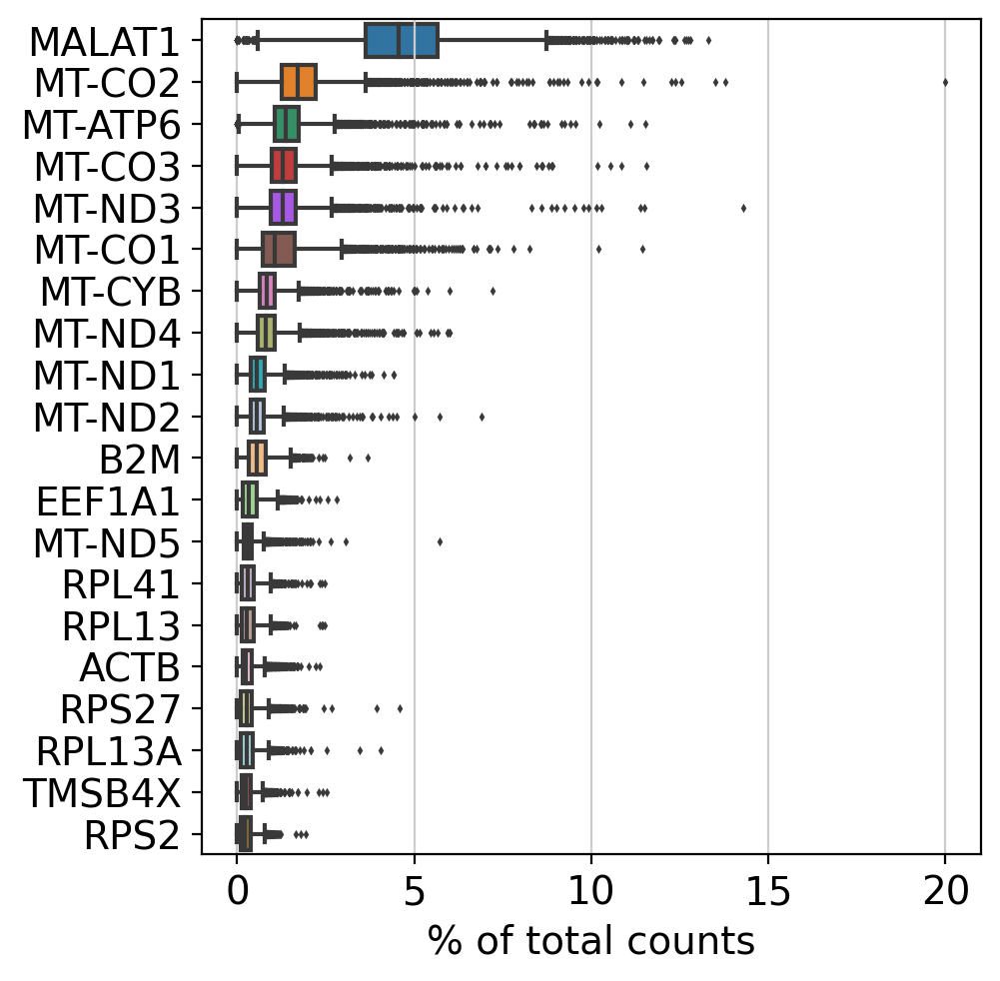

In [ ]:
sc.pl.highest_expr_genes(ad_rna, n_top=20, )

In [ ]:
def pp(adata):
    sc.pp.filter_cells(adata, min_genes=200) #get rid of cells with fewer than 200 genes
    sc.pp.filter_genes(adata, min_cells=3) #get rid of genes that are found in fewer than 3 cells

    adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    adata.var['rb'] = adata.var_names.str.startswith(('RPS','RPL'))  # annotate the group of ribosomal proteins as 'rb'
    sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
    sc.pp.calculate_qc_metrics(adata, qc_vars=['rb'], percent_top=None, log1p=False, inplace=True)
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt', 'pct_counts_rb'], jitter=0.4, multi_panel=True)

    sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')
    sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
    #upper_lim = np.quantile(adata.obs.n_genes_by_counts.values, .98)
    #lower_lim = np.quantile(adata.obs.n_genes_by_counts.values, .02)
    #adata = adata[(adata.obs.n_genes_by_counts < upper_lim) & (adata.obs.n_genes_by_counts > lower_lim)]
    adata = adata[adata.obs.n_genes_by_counts < 4000]
    adata = adata[adata.obs.pct_counts_mt < 20]
    sc.pp.normalize_total(adata, target_sum=1e4) #normalize every cell to 10,000 UMI
    sc.pp.log1p(adata) #change to log counts
    sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5) #these are default values
    sc.pl.highly_variable_genes(adata)
    adata.raw = adata #save raw data before processing values and further filtering
    adata = adata[:, adata.var.highly_variable] #filter highly variable
    sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt']) #Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed
    sc.pp.scale(adata, max_value=10) #scale each gene to unit variance
    sc.tl.pca(adata, svd_solver='arpack') # Principal component analysis
    sc.pl.pca(adata, color='CST3')
    sc.pl.pca_variance_ratio(adata, log=True)
    adata.write(results_file)
    #adata
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20) # Computing the neighborhood graph

    sc.tl.umap(adata) # Embedding the neighborhood graph
    return adata


/usr/local/lib/python3.10/dist-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


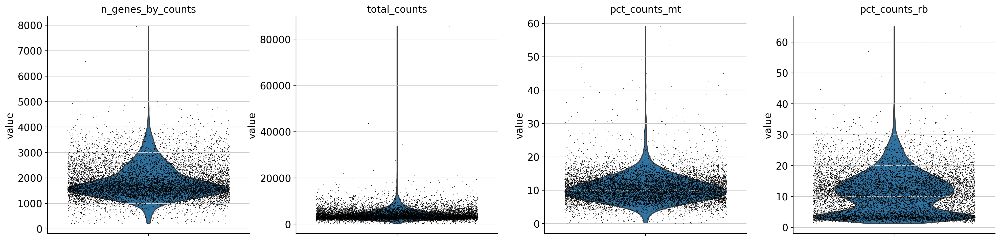

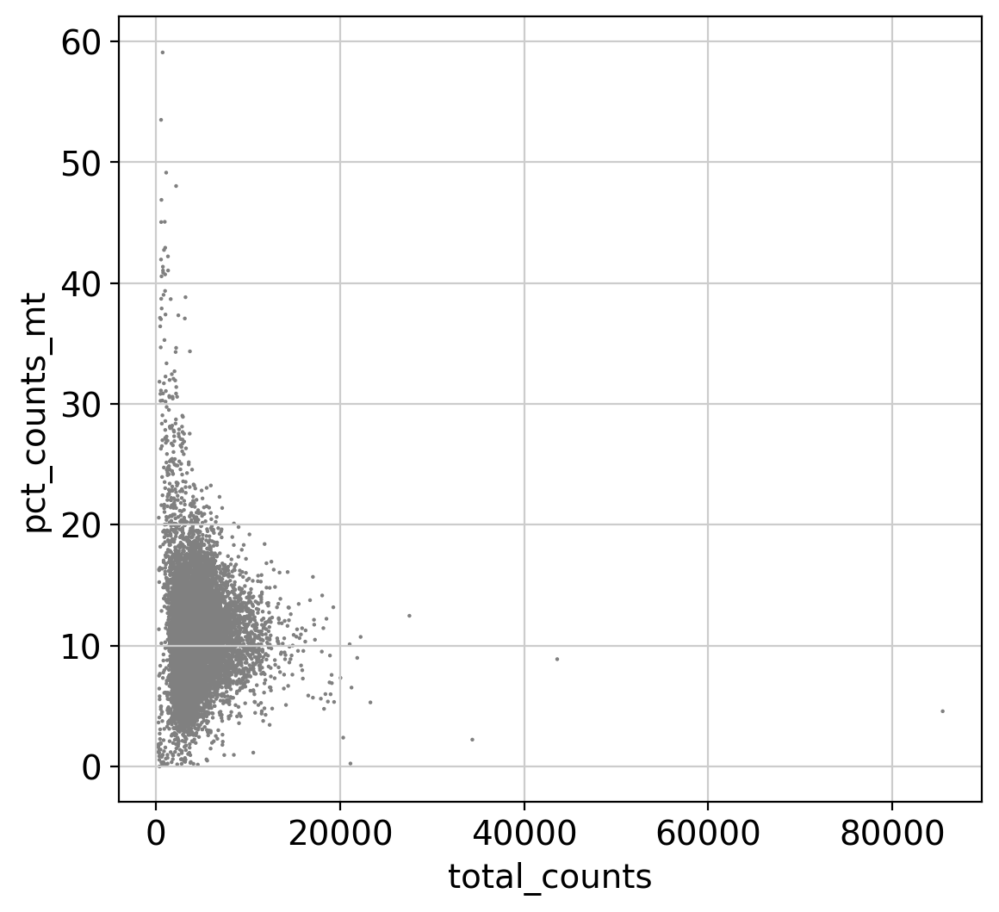

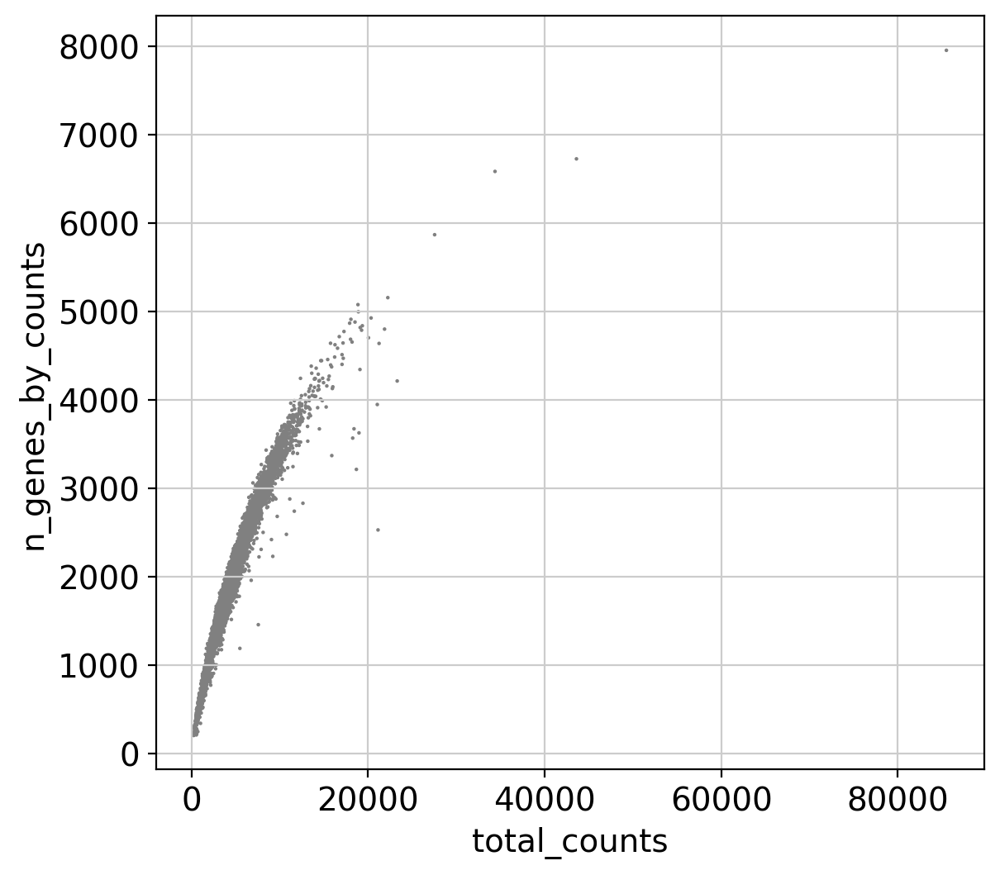

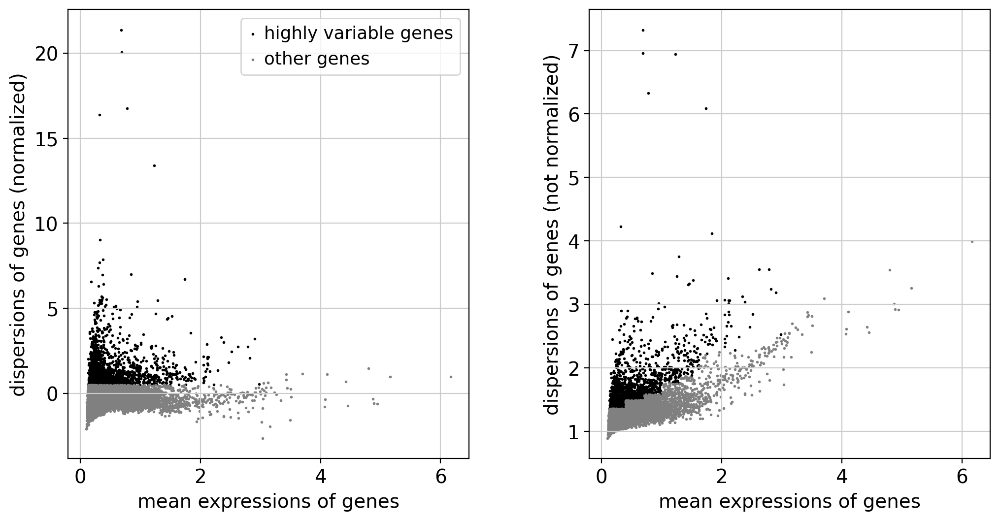

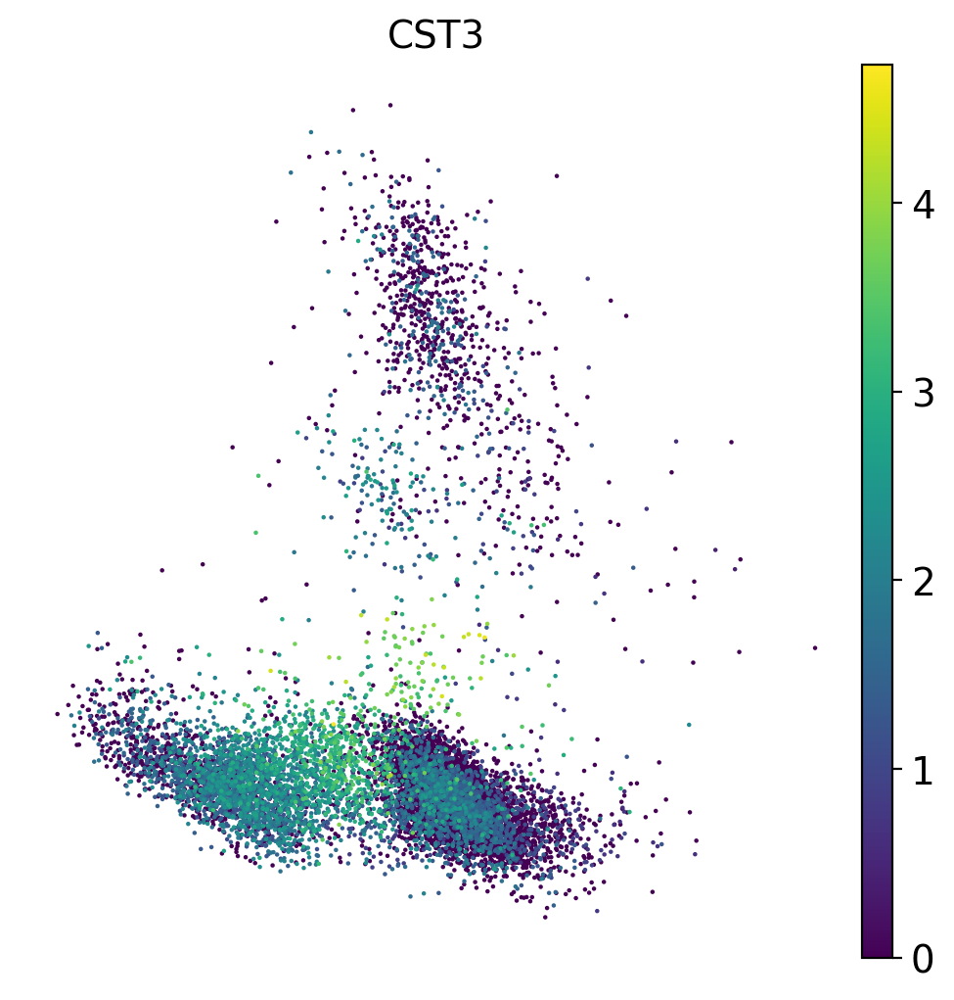

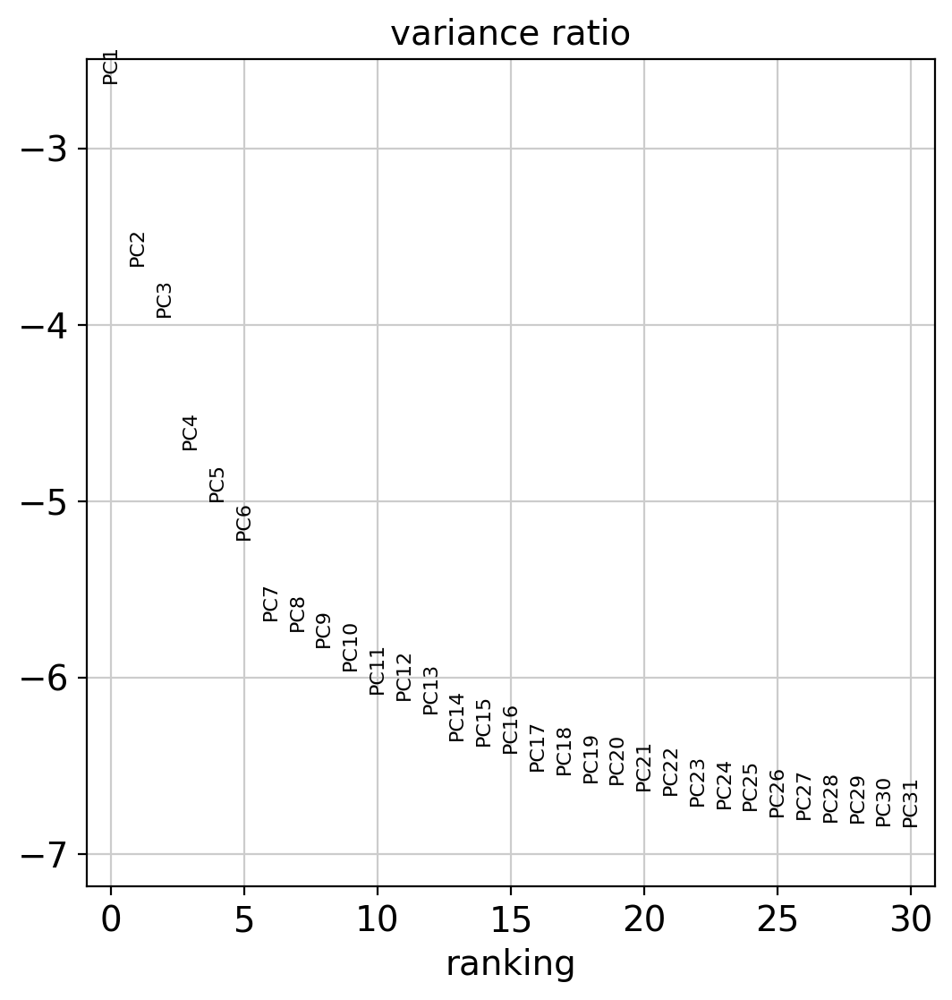

In [ ]:
ad_rna = pp(ad_rna) # pp處理後n_vars從8738降到1654 在11505個細胞上觀察這1654個基因

In [ ]:
np.sum(ad_rna.var.highly_variable)

1654

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

In [ ]:
#Define colors from red to blue
n_clusters = 6
n_colors = plt.cm.jet(np.linspace(0.9,0.1,n_clusters))
#for i in range(n_clusters):
#  subdata = data(labels==i)
#  subdata.plot.hist(bins=bins, alpha=0.5, color=colors[i],label='cluster {}'.format(i))
n_colors

array([[0.9456328 , 0.02977487, 0.        , 1.        ],
       [1.        , 0.62527233, 0.        , 1.        ],
       [0.74320051, 1.        , 0.22454143, 1.        ],
       [0.22454143, 1.        , 0.74320051, 1.        ],
       [0.        , 0.53529412, 1.        , 1.        ],
       [0.        , 0.        , 0.9456328 , 1.        ]])

In [ ]:
import matplotlib.colors as mcolors
#mcolors.is_color_like(n_colors[4])
n_colors_str = [mcolors.to_hex(color) for color in n_colors]

In [ ]:
n_colors_str

['#f10800', '#ff9f00', '#beff39', '#39ffbe', '#0088ff', '#0000f1']

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


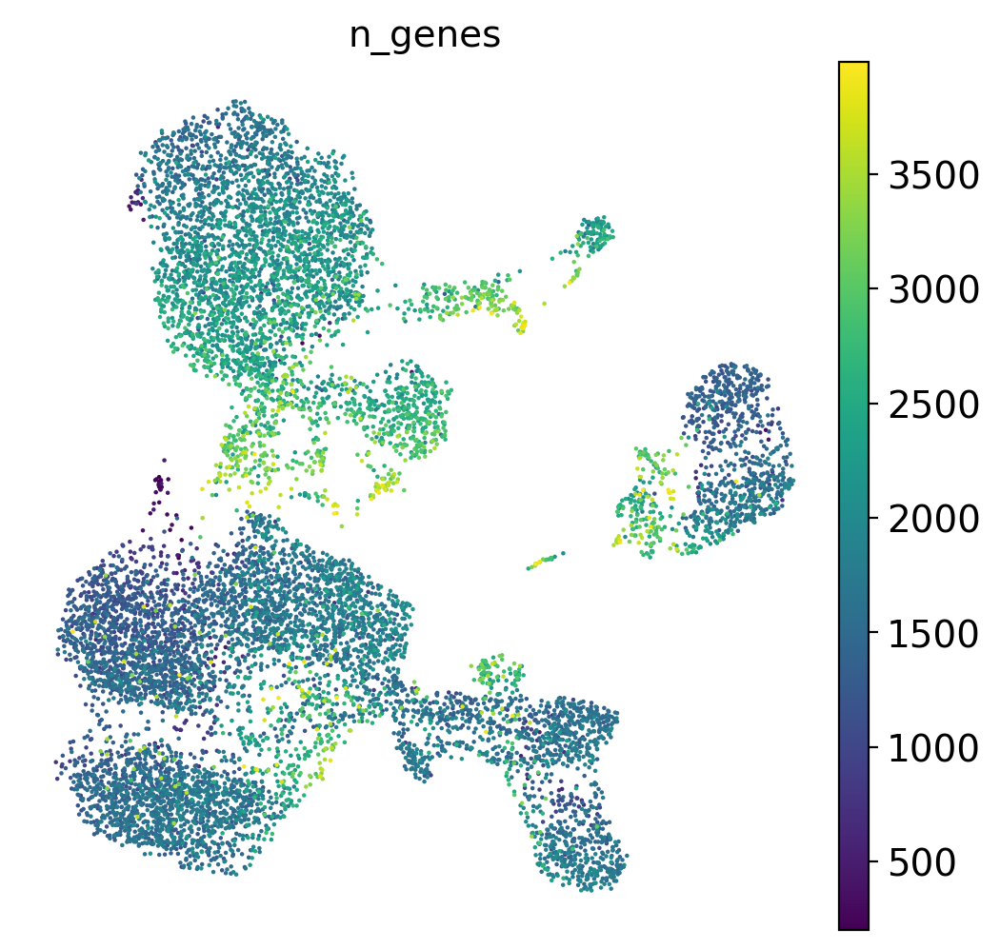

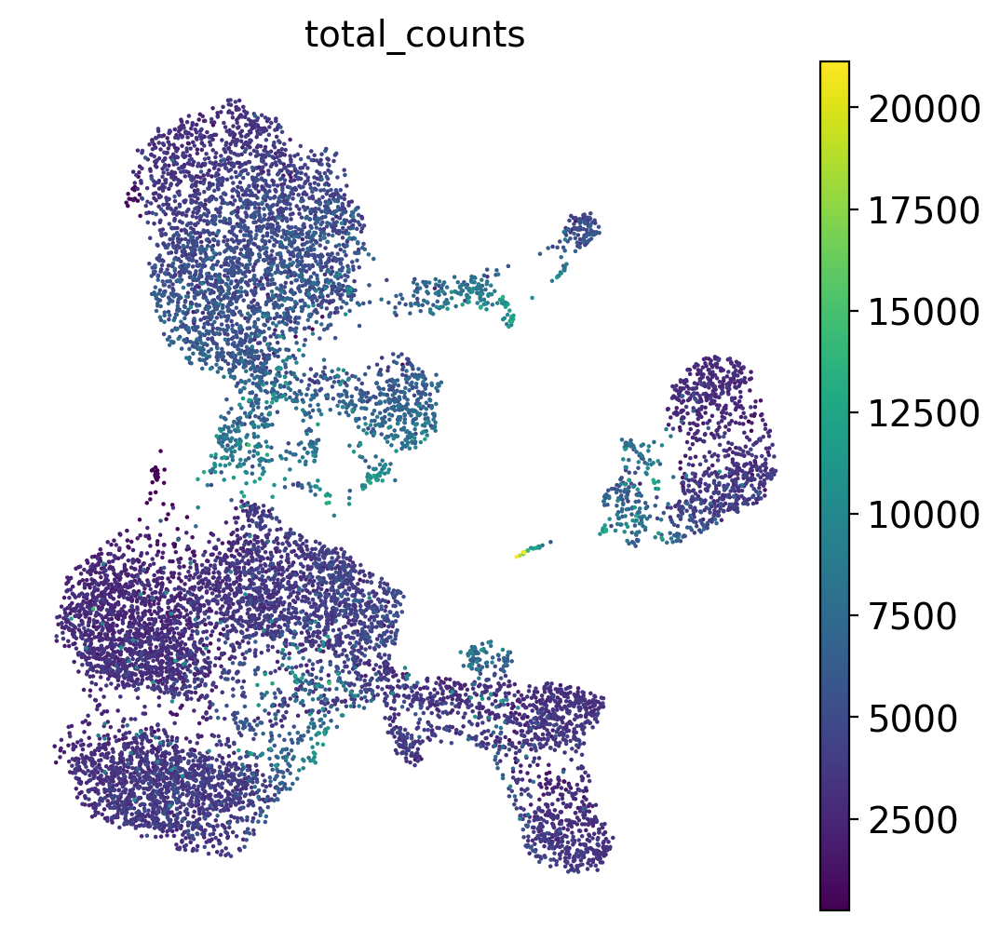

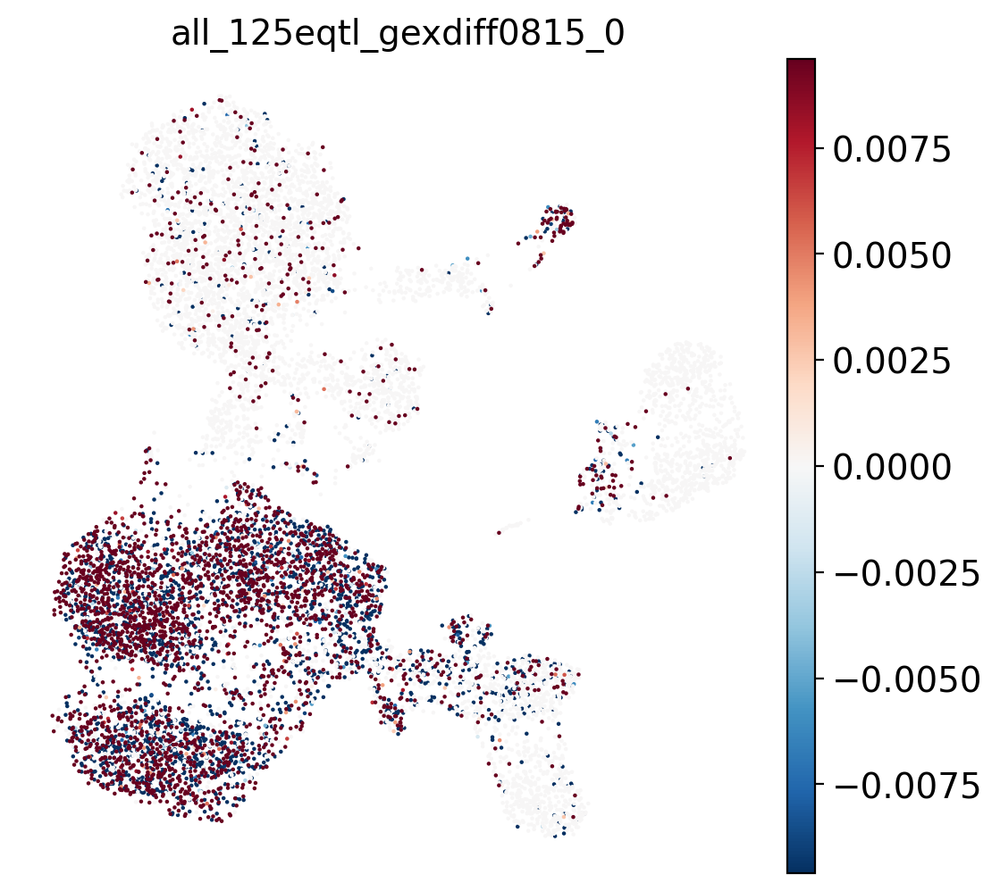

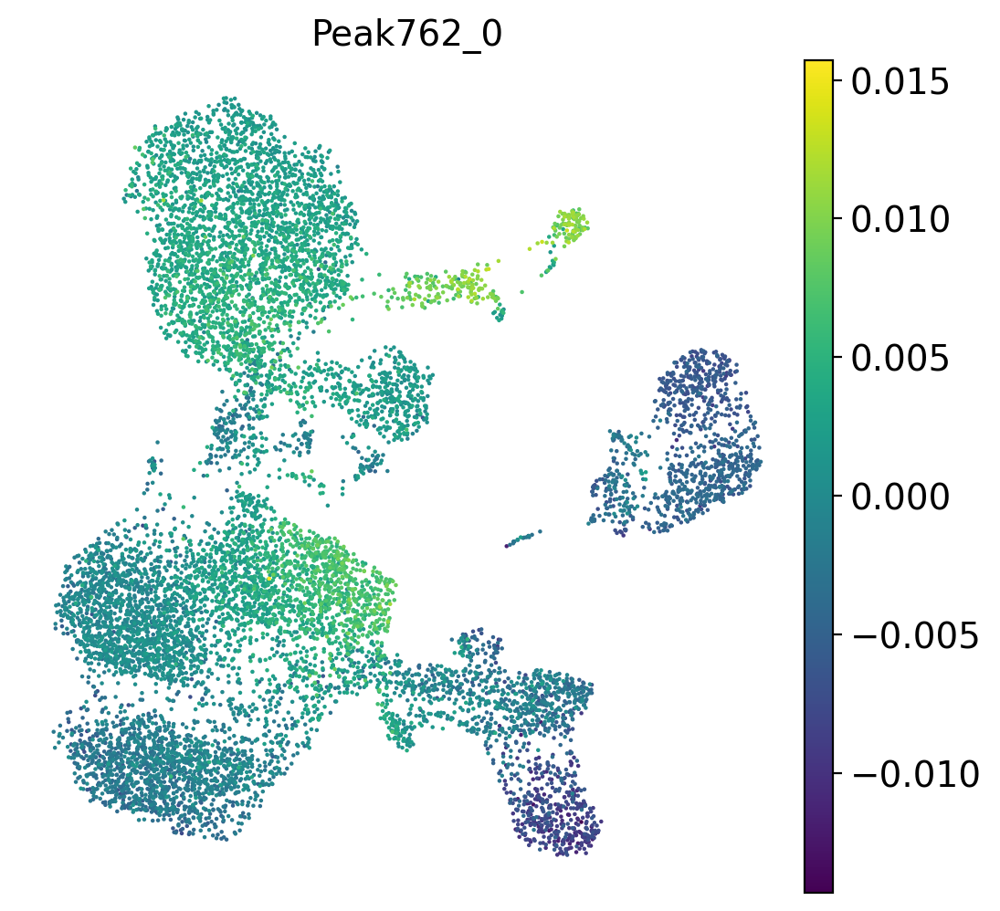

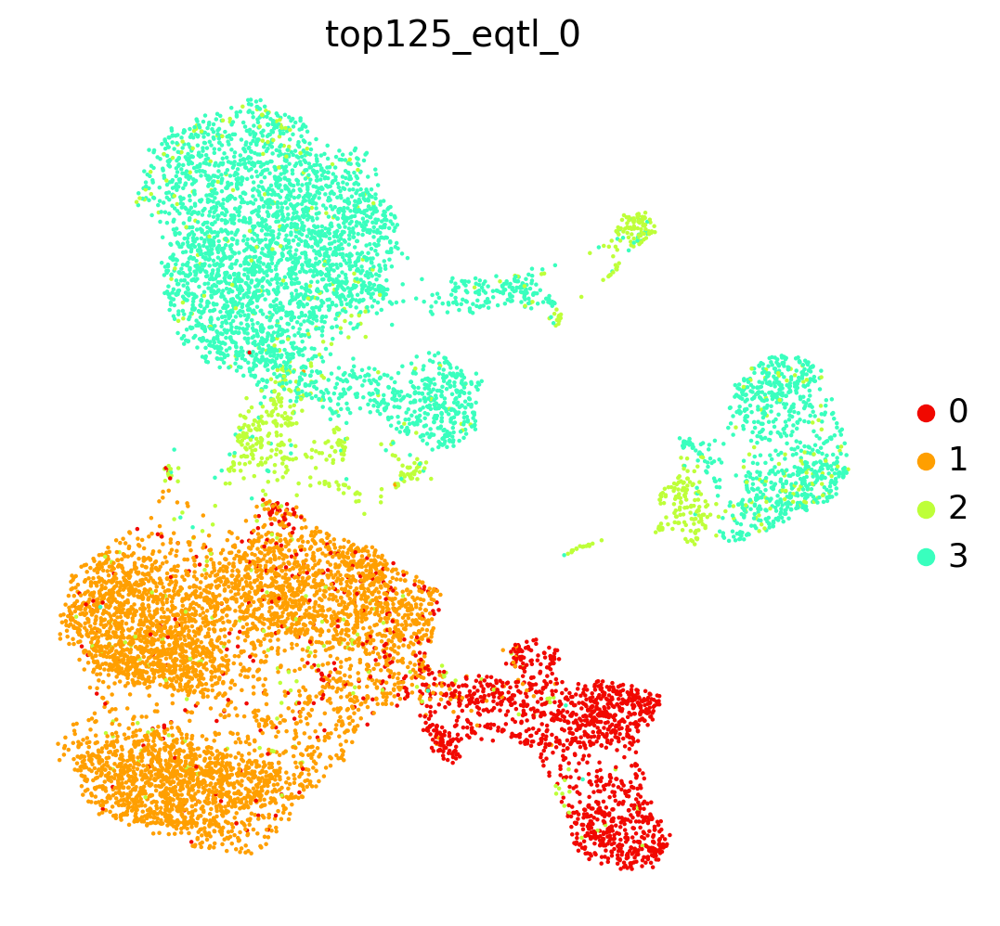

In [ ]:

sc.pl.umap(ad_rna, color = 'n_genes')
sc.pl.umap(ad_rna, color = 'total_counts')
sc.pl.umap(ad_rna, color = 'all_125eqtl_gexdiff0815_0',
           colorbar_loc = 'right',
           cmap = 'RdBu_r', #cmap='jet',
           vmin = -3*all125eqtl_gexdiff_std[0],
           vmax = 3*all125eqtl_gexdiff_std[0],
           vcenter = 0,)
sc.pl.umap(ad_rna, color = 'Peak762_0')
sc.pl.umap(ad_rna, color = 'top125_eqtl_0',palette = n_colors_str) #palette = 'jet'
#sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', size=110, frameon=False, save='.pdf')


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


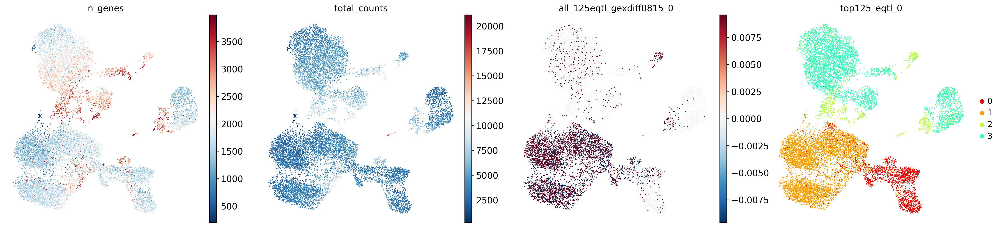

In [ ]:

sc.pl.umap(ad_rna, color = ['n_genes','total_counts','all_125eqtl_gexdiff0815_0','top125_eqtl_0'],
           colorbar_loc = 'right',
           cmap = 'RdBu_r', #cmap='jet',
           vmin = [None,None,-3*all125eqtl_gexdiff_std[0]],
           vmax = [None,None,3*all125eqtl_gexdiff_std[0]],
           vcenter = [None,None,0],
           palette={
               0: n_colors_str[0],
               1: n_colors_str[1],
               2: n_colors_str[2],
               3: n_colors_str[3],
               4: n_colors_str[4],
               5: n_colors_str[5],
              }

           #palette = n_colors_str #{ 'top125_eqtl_0': n_colors_str , 'top125_eqtl_124': 'jet', }, #palette = 'jet'
           )
#sc.pl.umap(adata, color='leiden', legend_loc='on data', title='', size=110, frameon=False, save='.pdf')


In [ ]:
#adata
# AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


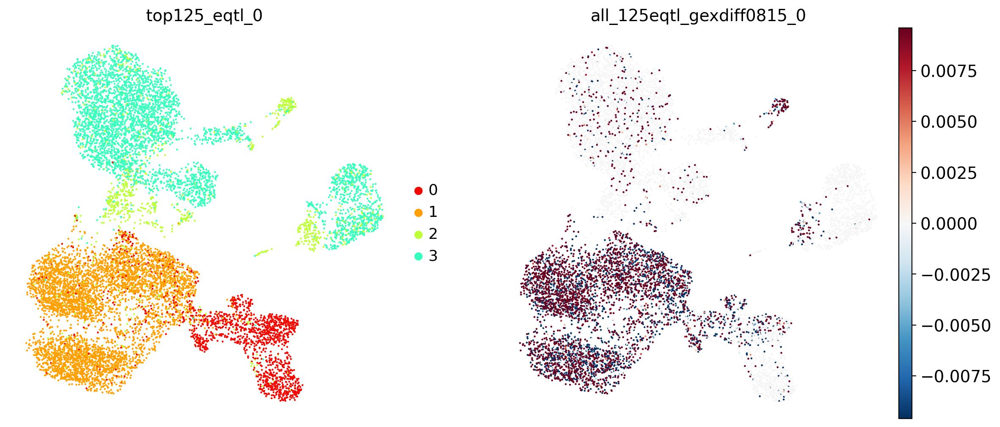

In [ ]:

sc.pl.umap(ad_rna, color = ['top125_eqtl_0','all_125eqtl_gexdiff0815_0'],colorbar_loc = 'right',cmap='RdBu_r',
           vmin = -3*all125eqtl_gexdiff_std[0],vmax = 3*all125eqtl_gexdiff_std[0],
           vcenter = 0,palette = n_colors_str) #,legend_loc = 'None'


In [ ]:
#adata
# AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

## Clustering leiden

In [ ]:
def cluster(adata):
  sc.tl.leiden(adata) # Clustering the neighborhood graph 用leiden做cluster

In [ ]:
cluster(ad_rna) # uns中多了leiden

In [ ]:
#ad_rna # AnnData object with n_obs × n_vars = 11505 × 1654
'''
obs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors', 'leiden'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
'''

"\nobs: 'all_368eqtl_gexdiff0801_367', 'top125_eqtl_124', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'top125_eqtl_124_colors', 'leiden'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n"

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


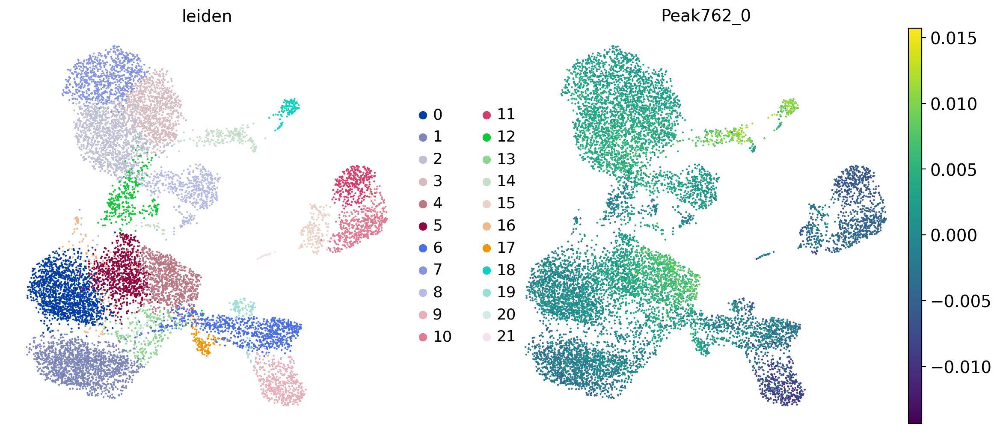

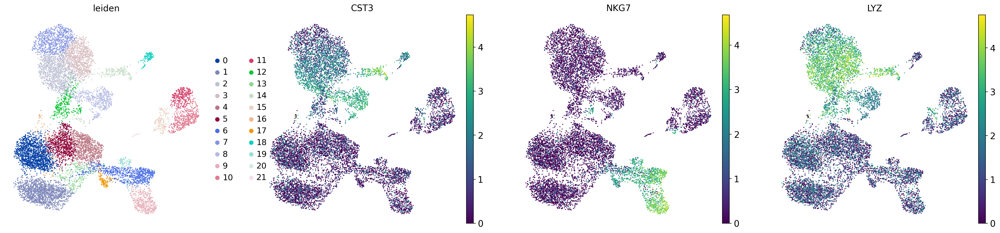

In [ ]:
sc.pl.umap(ad_rna, color=['leiden','Peak762_0'])
sc.pl.umap(ad_rna, color=['leiden','CST3', 'NKG7', 'LYZ']) # 'MS4A1',

In [ ]:
ad_rna.obs['leiden'].value_counts()

0     1529
1     1496
2     1148
3      852
4      833
5      832
6      817
7      763
8      557
9      451
10     438
11     325
12     315
13     243
14     215
15     183
16     127
17     118
18     112
19     105
20      27
21      19
Name: leiden, dtype: int64

In [ ]:
ad_rna.write(results_file)

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654 uns多了leiden_colors
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

## 使用不同的統計檢驗方法 t-test/wilcoxon/logreg 在不同的'leiden'分群之間進行差異基因分析，再將具有顯著差異表達的前25個基因，繪製差異基因分析的結果,sharey=False則是指在繪製差異基因的條形圖時不共享y軸刻度。

In [ ]:
def marker(adata): # Finding marker genes
  sc.tl.rank_genes_groups(adata, 'leiden', method='t-test')
  sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)
  sc.settings.verbosity = 2  # reduce the verbosity
  sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon') # 使用Wilcoxon統計檢驗在不同的'leiden'分群之間進行差異基因分析
  sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False) # 將具有顯著差異表達的前25個基因，繪製差異基因分析的結果,sharey=False則是指在繪製差異基因的條形圖時不共享y軸刻度。
  adata.write(results_file) # 保存到檔案中
  sc.tl.rank_genes_groups(adata, 'leiden', method='logreg')
  sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)


/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result

ranking genes
    finished (0:00:24)


/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:396: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'names'] = self.var_names[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:398: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, 'scores'] = scores[global_indices]
/usr/local/lib/python3.10/dist-packages/scanpy/tools/_rank_genes_groups.py:401: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result

ranking genes
    finished (0:02:28)


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


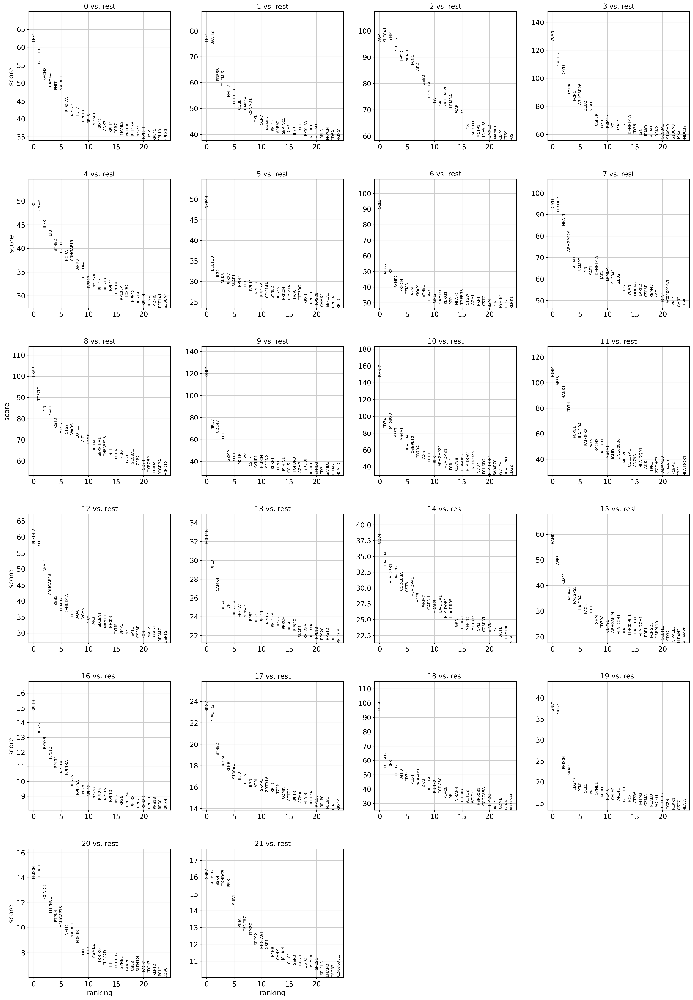

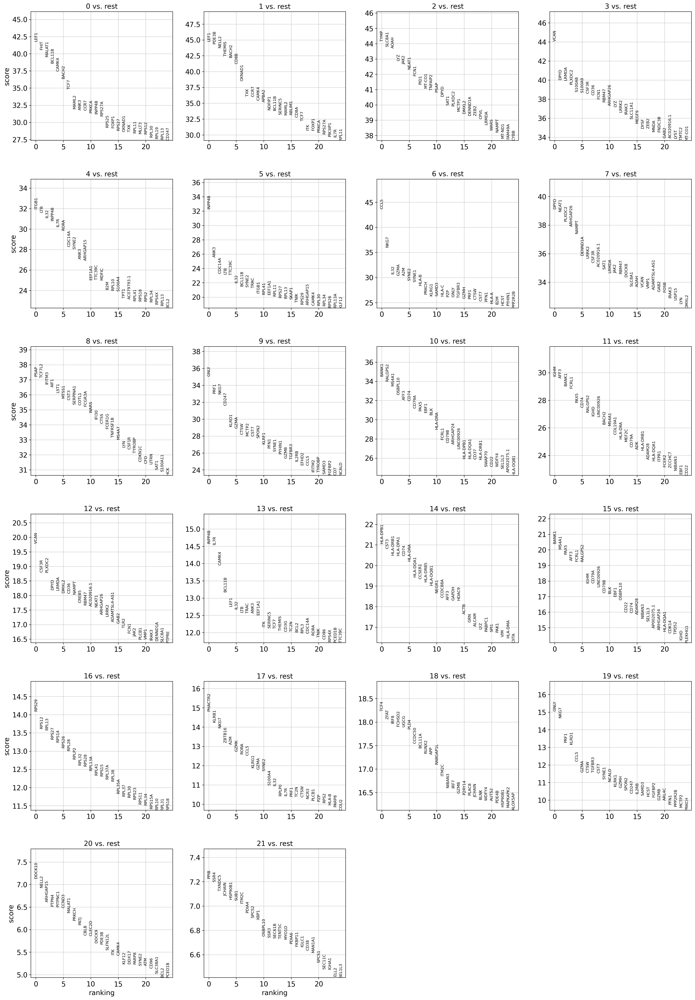

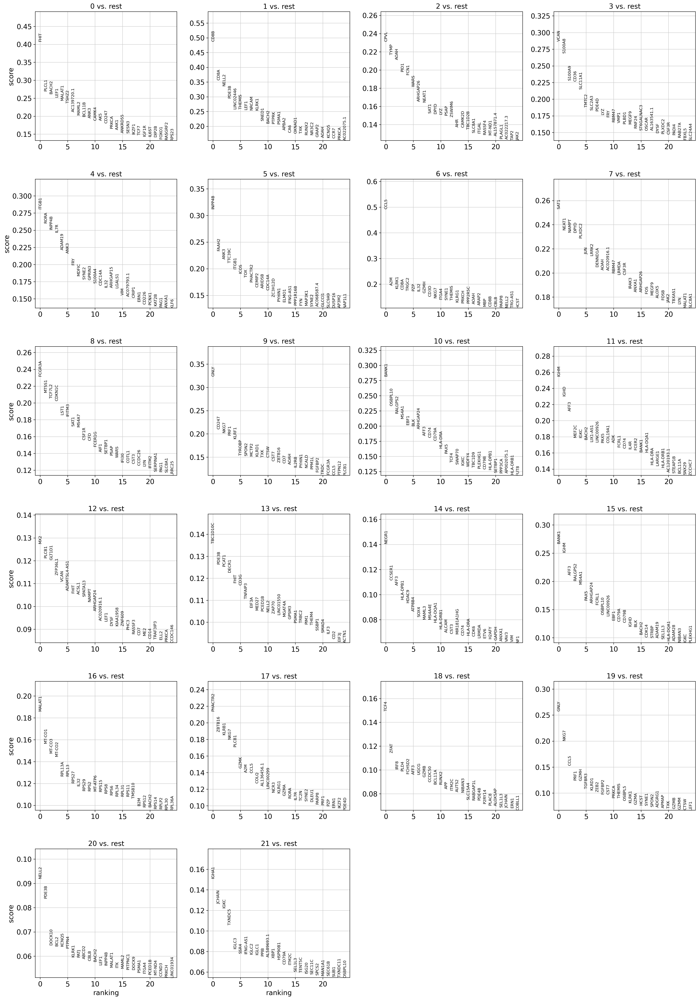

In [ ]:
marker(ad_rna)

## 根據前面基因表達的差異結果,手動挑出marker genes (dotplot和stacked_violin會用到)

In [ ]:
marker_genes = [
    'MALAT1',
    'CD74',
    'LYZ',
    'S100A8',
    'CD37',
    'LTB',

    'LEF1',
    'IL32',
    'IL7R',
    'CD3D',
    "CD3E",
    "CD2",

    "CD3G",
    'ITGB1',
    'GNLY',
    'NKG7',


    'CD36',
    'LST1',
    'CST3', # Dendritic Cells
    'VCAN',
    'CD14',
    'TCF4',
    'BANK1',
    'CD79A',
    'CD79B',
    'MS4A1',
    'CD22',
    'PLD4',
    'MS4A7',
    'FCGR3A',

    'CST7',
    'KLRD1',

    'KLRB1',
    'KLRF1',
    'CD8A',
    'CD8B',

    ]


# ['CD3D-', 'CD3E-', 'CD4-', 'CD8A-', 'FCER1A', 'LCK-', 'MSR1', 'NCAM1', 'NCR1']''LCK','CST3','SPI1','LGALS3',"MAFB",  08/11重新根據差異基因分析的結果選擇marker genes

In [ ]:
'''
marker_genes = ['LCK','CD3D','KLRD1','SPI1','MS4A1','CD36','IL7R', 'CD79A',
                'MS4A1', 'CD8A', 'CD8B', 'LYZ', 'CD14',
                'LGALS3', 'S100A8', 'GNLY', 'NKG7', 'KLRB1',
                'FCGR3A', 'MS4A7', 'CST3', "CD3E","CD3G","CD2","MAFB",]
# ['CD3D-', 'CD3E-', 'CD4-', 'CD8A-', 'FCER1A', 'LCK-', 'MSR1', 'NCAM1', 'NCR1']'  07/31多加了CST3後面的marker genes，剩下的是在adata 1654裡找不到的gene
'''

'\nmarker_genes = [\'LCK\',\'CD3D\',\'KLRD1\',\'SPI1\',\'MS4A1\',\'CD36\',\'IL7R\', \'CD79A\',\n                \'MS4A1\', \'CD8A\', \'CD8B\', \'LYZ\', \'CD14\',\n                \'LGALS3\', \'S100A8\', \'GNLY\', \'NKG7\', \'KLRB1\',\n                \'FCGR3A\', \'MS4A7\', \'CST3\', "CD3E","CD3G","CD2","MAFB",]\n# [\'CD3D-\', \'CD3E-\', \'CD4-\', \'CD8A-\', \'FCER1A\', \'LCK-\', \'MSR1\', \'NCAM1\', \'NCR1\']\'  07/31多加了CST3後面的marker genes，剩下的是在adata 1654裡找不到的gene\n'

In [ ]:
#marker_genes = ['LCK','CD3D','KLRD1','SPI1','MS4A1','CD36','IL7R', 'CD79A',
#                'MS4A1', 'CD8A', 'CD8B', 'LYZ', 'CD14',
#                'LGALS3', 'S100A8', 'GNLY', 'NKG7', 'KLRB1',
#                'FCGR3A', 'MS4A7', 'CST3']
#'FCER1A',"CD3E","CD3G","CD2","NCAM1","NCR1","CD3D-","CD3E-","CD8A-",
#"CD4-","LCK-","MAFB","MSR1"]

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'log1p', 'hvg', 'pca', 'neighbors', 'umap', 'top125_eqtl_0_colors', 'leiden', 'leiden_colors', 'rank_genes_groups'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'distances', 'connectivities'\n"

In [ ]:
ad_rna = sc.read(results_file)
ad_rna.uns['log1p']["base"] = None #add this workaround to solve pbmc10k data issue which cause error
                   #Fix checking of log1p transformation base value when that value is None

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
pd.DataFrame(ad_rna.uns['rank_genes_groups']['names']).head(5)

,0,1,2,3,4,5,6,7,8,9,...,12,13,14,15,16,17,18,19,20,21
0,LEF1,LEF1,TYMP,VCAN,ITGB1,INPP4B,CCL5,DPYD,PSAP,GNLY,...,VCAN,INPP4B,HLA-DPB1,BANK1,RPS29,PHACTR2,TCF4,GNLY,DOCK10,PPIB
1,FHIT,PDE3B,SLC8A1,DPYD,LTB,ANK3,NKG7,NEAT1,TCF7L2,PRF1,...,CSF3R,IL7R,CST3,MS4A1,RPS12,KLRB1,ZFAT,NKG7,NELL2,SSR4
2,MALAT1,NELL2,AOAH,LRMDA,IL32,CDC14A,IL32,PLXDC2,IFITM3,NKG7,...,PLXDC2,CAMK4,HLA-DRB1,PAX5,RPL13,NKG7,IRF8,PRF1,ARHGAP15,TXNDC5
3,BCL11B,THEMIS,LYZ,PLXDC2,INPP4B,LTB,GZMA,ARHGAP26,AIF1,CD247,...,DPYD,BCL11B,HLA-DPA1,AFF3,RPS27,ZBTB16,FCHSD2,KLRD1,PTPN4,JCHAIN
4,CAMK4,BACH2,JAK2,S100A8,IL7R,TTC39C,A2M,NAMPT,LST1,KLRD1,...,LRMDA,LEF1,CD74,FCRL1,RPS14,A2M,UGCG,CCL5,PITPNC1,HSP90B1


In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

## 解析adata中的基因排名結果，並將結果轉換成一個Pandas DataFrame，以便進行後續分析和可視化。

In [ ]:
rna_result = ad_rna.uns['rank_genes_groups']
rna_groups = rna_result['names'].dtype.names
pd.DataFrame(
    {group + '_' + key[:1]: rna_result[key][group]
    for group in rna_groups for key in ['names', 'pvals']}).head(5)

,0_n,0_p,1_n,1_p,2_n,2_p,3_n,3_p,4_n,4_p,...,17_n,17_p,18_n,18_p,19_n,19_p,20_n,20_p,21_n,21_p
0,LEF1,0.000000e+00,LEF1,0.0,TYMP,0.0,VCAN,0.0,ITGB1,2.270712e-224,...,PHACTR2,9.176370e-50,TCF4,2.705025e-74,GNLY,2.958881e-51,DOCK10,9.746459e-13,PPIB,4.957953e-13
1,FHIT,0.000000e+00,PDE3B,0.0,SLC8A1,0.0,DPYD,0.0,LTB,8.242613e-220,...,KLRB1,4.112695e-46,ZFAT,5.929713e-73,NKG7,8.377385e-49,NELL2,4.160785e-12,SSR4,6.070100e-13
2,MALAT1,0.000000e+00,NELL2,0.0,AOAH,0.0,LRMDA,0.0,IL32,1.685700e-212,...,NKG7,2.677112e-44,IRF8,3.194435e-72,PRF1,2.732247e-40,ARHGAP15,3.826062e-11,TXNDC5,1.051320e-12
3,BCL11B,0.000000e+00,THEMIS,0.0,LYZ,0.0,PLXDC2,0.0,INPP4B,2.232772e-208,...,ZBTB16,1.007537e-39,FCHSD2,1.019688e-71,KLRD1,1.459950e-39,PTPN4,7.102271e-11,JCHAIN,1.405029e-12
4,CAMK4,3.834693e-307,BACH2,0.0,JAK2,0.0,S100A8,0.0,IL7R,1.345231e-200,...,A2M,3.662133e-39,UGCG,1.250858e-71,CCL5,3.061196e-34,PITPNC1,7.721829e-11,HSP90B1,1.710155e-12


In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

ranking genes
    finished (0:00:05)


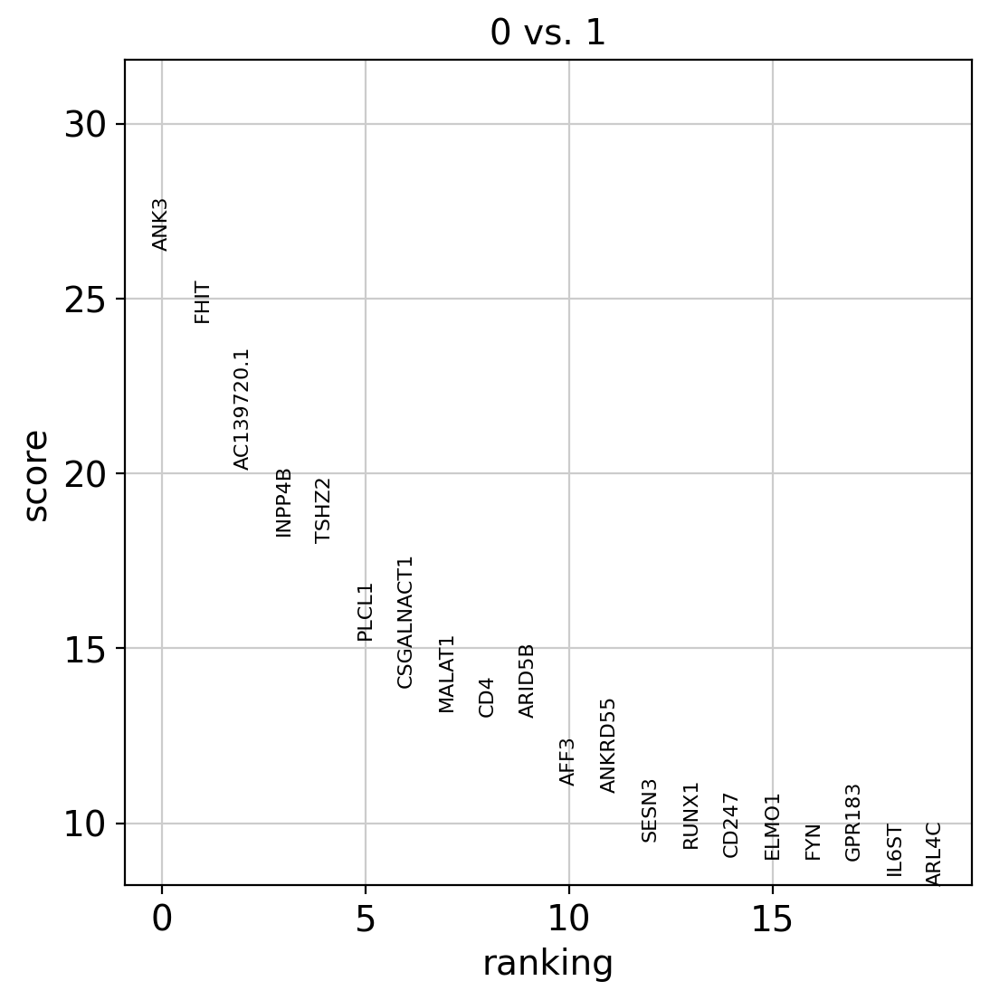

In [ ]:
sc.tl.rank_genes_groups(ad_rna, 'leiden', groups=['0'], reference='1', method='wilcoxon')
sc.pl.rank_genes_groups(ad_rna, groups=['0'], n_genes=20)

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


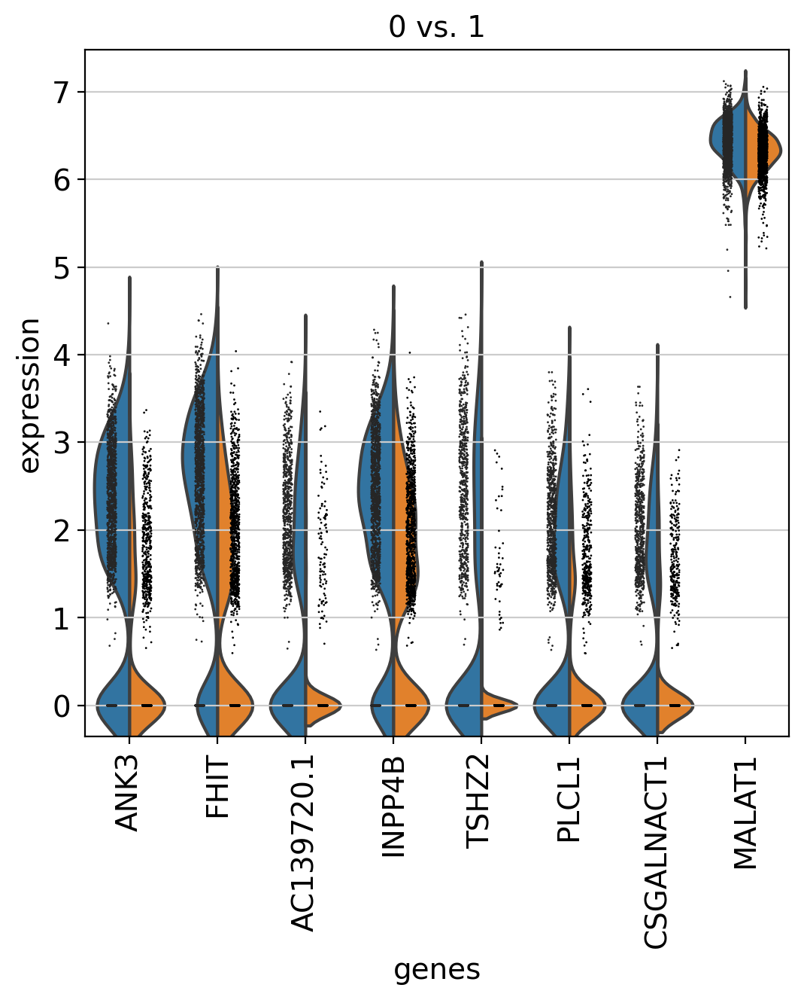

In [ ]:
sc.pl.rank_genes_groups_violin(ad_rna, groups='0', n_genes=8)

In [ ]:
#adata.uns['rank_genes_groups']

In [ ]:
ad_rna = sc.read(results_file)
#adata.uns['log1p']["base"] = None #add this workaround to solve pbmc10k data issue which cause error
                   #Fix checking of log1p transformation base value when that value is None

In [ ]:
ad_rna.uns['rank_genes_groups']

{'logfoldchanges': array([( 3.0152636 ,  3.2193754,  3.2857926,  4.8885045,  2.8168287,  2.900599  ,  5.7902255,  2.8916094,  3.46756  ,  6.915102 ,  6.979989 ,  7.4215283,  3.1655562 ,  2.2672887,  3.8197105,  5.153724  ,  1.5248973,  3.2822018,  7.512587 ,  5.1000447,  2.0597596,  4.4368753),
        ( 3.0315561 ,  2.8163207,  4.0622125,  2.8044295,  2.5076673,  2.5063055 ,  4.500117 ,  3.064689 ,  4.8098884,  5.9390364,  5.8592954,  5.891585 ,  2.5332823 ,  2.227654 ,  3.9313314,  4.7346396 ,  1.5743107,  4.8560963,  6.619215 ,  4.292771 ,  3.908926 ,  4.0271716),
        ( 0.53524286,  3.9501204,  2.9742935,  4.031399 ,  2.467087 ,  1.835168  ,  2.4548328,  4.1781425,  4.5888023,  5.677354 ,  6.6221905,  6.441042 ,  3.1626337 ,  2.1297393,  3.61031  ,  4.5032287 ,  1.4306526,  3.7458375,  5.3222475,  3.8091052,  1.7149056,  8.387401 ),
        ...,
        (-0.7129294 , -5.253939 , -1.6318828, -1.9632967, -4.9754   , -0.50314224, -4.5180974, -2.7464411, -3.8870313, -4.316707 , -3.7

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:black'` for same effect.
  warnings.warn(msg, FutureWarning)


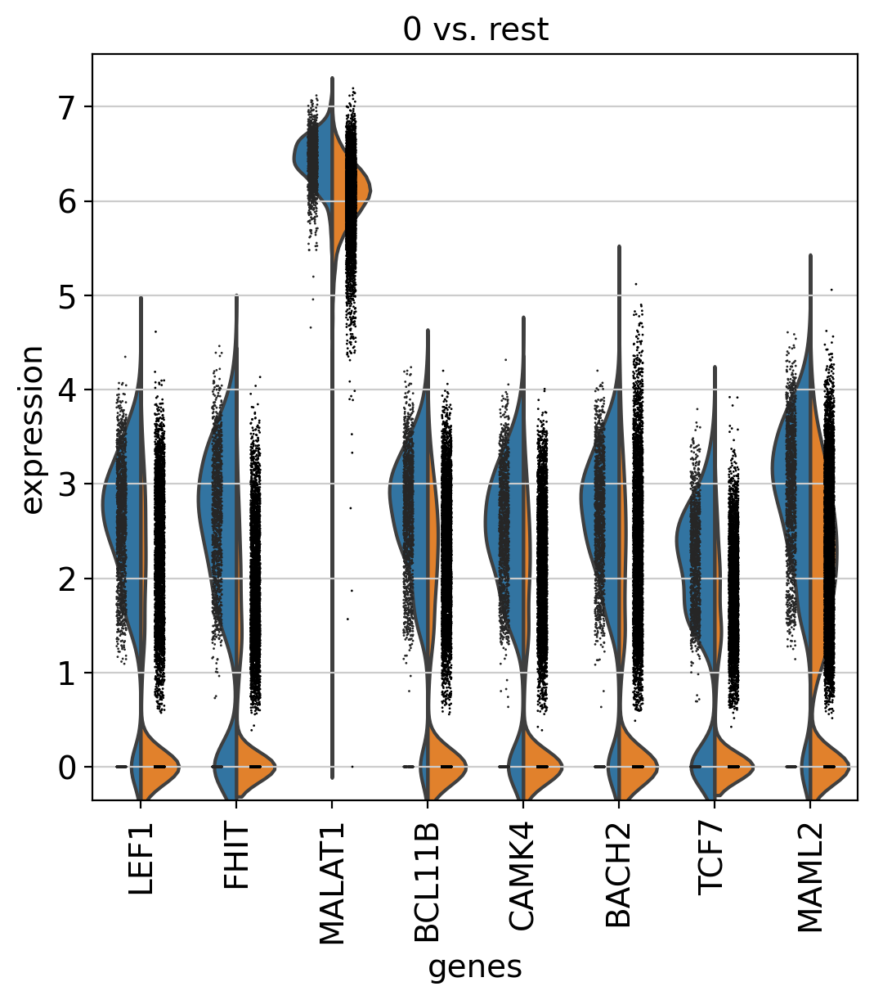

In [ ]:
sc.pl.rank_genes_groups_violin(ad_rna, groups='0', n_genes=8)

[<Axes: xlabel='leiden', ylabel='CST3'>,
 <Axes: xlabel='leiden', ylabel='NKG7'>,
 <Axes: xlabel='leiden', ylabel='MS4A1'>,
 <Axes: xlabel='leiden', ylabel='LYZ'>]

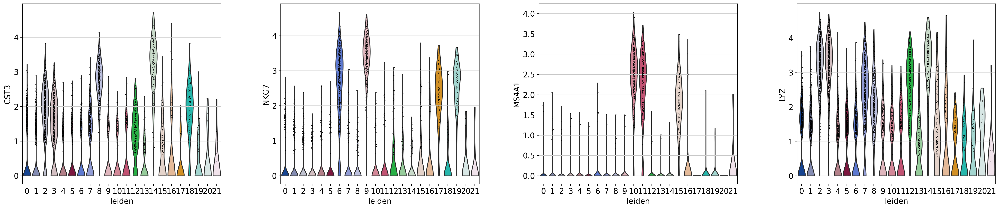

In [ ]:
sc.pl.violin(ad_rna, ['CST3', 'NKG7', 'MS4A1', 'LYZ'], groupby='leiden')

## 根據以上rank_genes_groups的結果，手動標註annotation細胞類別Cell Type

In [ ]:
#mu.pp.filter_obs(ad_rna, "leiden", lambda x: ~x.isin(["2", "7", "12", "16"]))
# Analogous to
#   rna = rna[~rna.obs.leiden.isin(["9", "15", "12", "16"])]
# but doesn't copy the object

In [ ]:
new_cluster_names = {
    "0": "CD4 Naive",
    "1": "CD8 Naive",
    "2": "Noise-Liver",
    "3": "CD14 Mono",
    "4": "CD4 TCM",
    "5": "CD4 TEM",
    "6": "gdT",
    "7": "Noise-Hepatic stellate cells",
    "8": "CD16 Mono",
    "9": "NK",
    "10": "B naive",
    "11": "B memory",
    "12": "Erythroid-like and erythroid precursor cells", # CD14+ Monocyte
    "13": "CD8 TCM",
    "14": "Plasmacytoid Dendritic cells",
    "15": "B intermediate",
    "16": "Ribosomal Proteins RPS RPL",
    "17": "MAIT",
    "18": "pDC",
    "19": "CD8 TEM",
    "20": "dnT",
    "21": "Plasmablast",

}

ad_rna.obs['celltype'] = ad_rna.obs.leiden.astype("str").values
ad_rna.obs.celltype = ad_rna.obs.celltype.astype("category")
ad_rna.obs.celltype = ad_rna.obs.celltype.cat.rename_categories(new_cluster_names)

In [ ]:
'''
new_cluster_names = [
"CD4 Naive", "CD4 TCM", "CD4 CTL", "CD4 TEM", "CD4 Proliferating",
"CD8 Naive", "dnT", "CD8 TEM", "CD8 TCM", "CD8 Proliferating",
"MAIT", "NK", "NK_CD56bright", "NK Proliferating", "gdT",
"Treg", "B naive", "B intermediate", "B memory", "Plasmablast"
,"CD14 Mono",'CD16 Mono'                 ]
ad_rna.rename_categories('leiden', new_cluster_names)
'''

'\nnew_cluster_names = [\n"CD4 Naive", "CD4 TCM", "CD4 CTL", "CD4 TEM", "CD4 Proliferating",\n"CD8 Naive", "dnT", "CD8 TEM", "CD8 TCM", "CD8 Proliferating",\n"MAIT", "NK", "NK_CD56bright", "NK Proliferating", "gdT",\n"Treg", "B naive", "B intermediate", "B memory", "Plasmablast"\n,"CD14 Mono",\'CD16 Mono\'                 ]\nad_rna.rename_categories(\'leiden\', new_cluster_names)\n'

In [ ]:
ad_rna.obs['celltype'].value_counts()

CD4 Naive                                       1529
CD8 Naive                                       1496
Noise-Liver                                     1148
CD14 Mono                                        852
CD4 TCM                                          833
CD4 TEM                                          832
gdT                                              817
Noise-Hepatic stellate cells                     763
CD16 Mono                                        557
NK                                               451
B naive                                          438
B memory                                         325
Erythroid-like and erythroid precursor cells     315
CD8 TCM                                          243
Plasmacytoid Dendritic cells                     215
B intermediate                                   183
Ribosomal Proteins RPS RPL                       127
MAIT                                             118
pDC                                           

In [ ]:
#ad_rna

In [ ]:
#ad_rna.uns['celltype_colors']

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


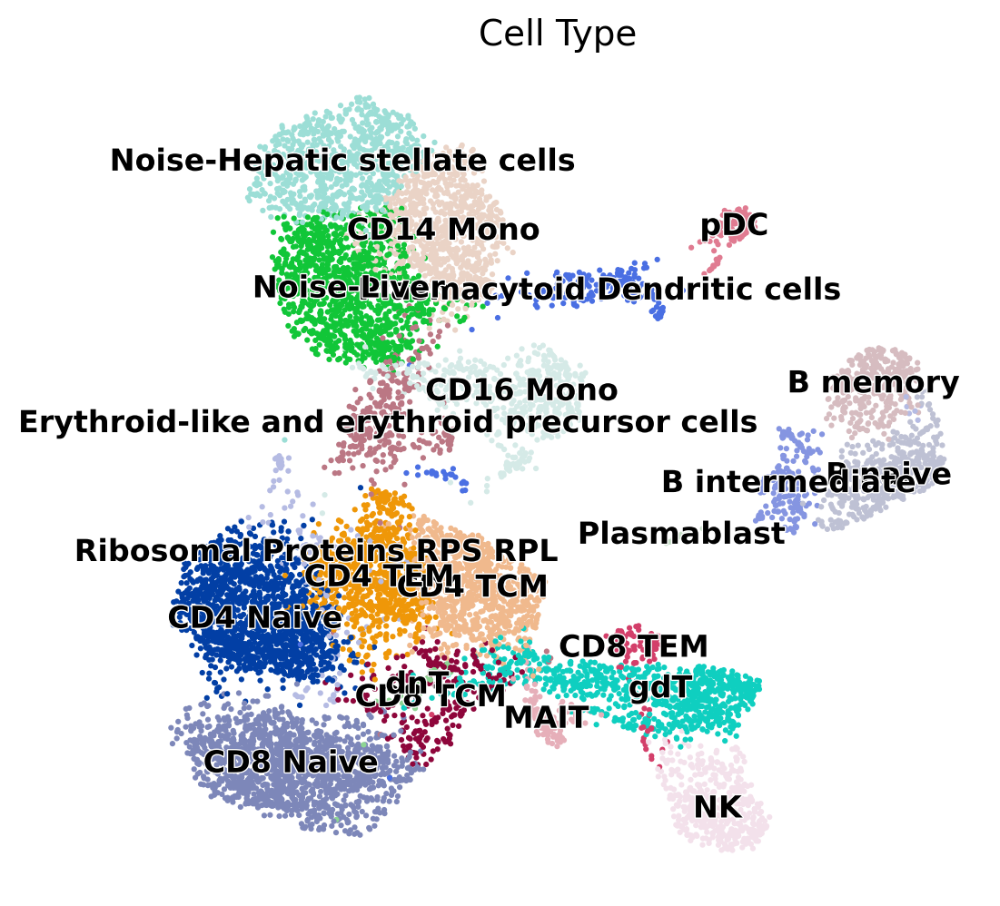

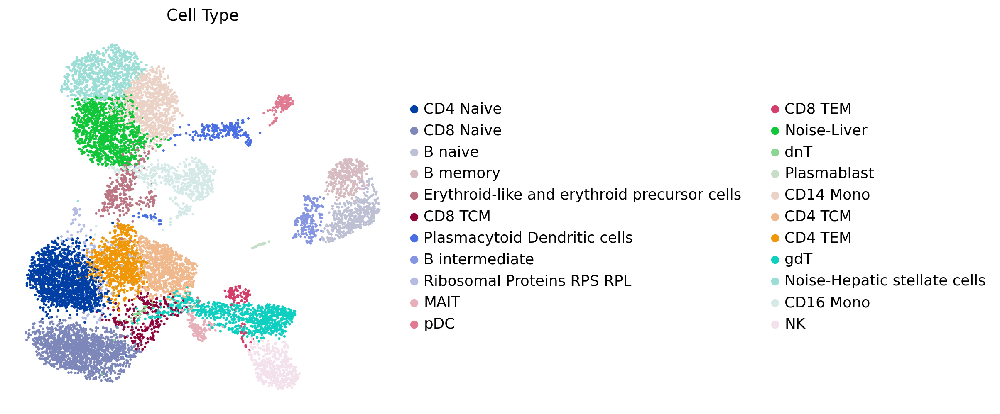

In [ ]:
sc.pl.umap(ad_rna, color='celltype', legend_loc='on data', legend_fontsize=12, legend_fontoutline=1, title='Cell Type', size=20, frameon=False,) # save='CellType.pdf') # legend_fontsize="xx-small"
sc.pl.umap(ad_rna, color='celltype', title='Cell Type', size=20, frameon=False,) # save='Cell_Type.pdf')

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


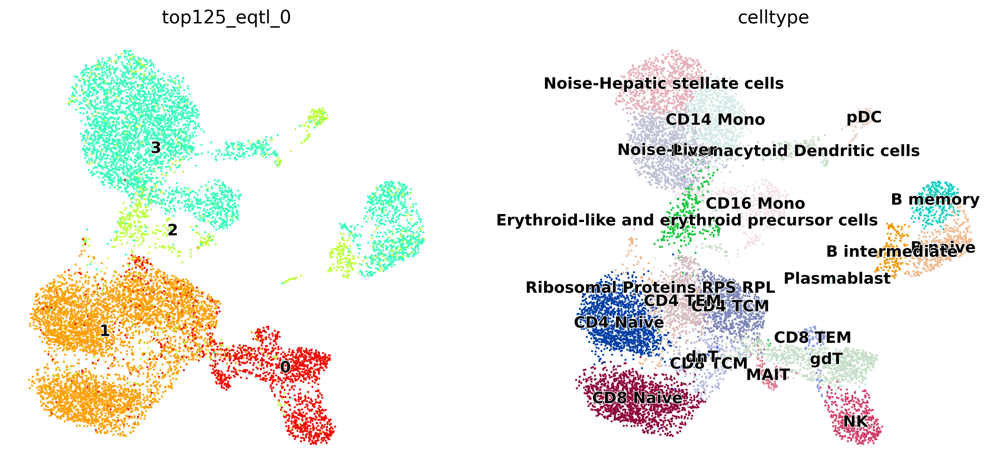

In [ ]:

sc.pl.umap(ad_rna, color = ['top125_eqtl_0','celltype',],
           legend_loc='on data', legend_fontsize=12, legend_fontoutline=1,
           #palette='jet',)

       palette={
           0: n_colors_str[0],
           1: n_colors_str[1],
           2: n_colors_str[2],
           3: n_colors_str[3],
           4: n_colors_str[4],
           "Noise-Liver" : '#bec1d4',
           "Noise-Hepatic stellate cells" :  '#e6afb9',
           'Erythroid-like and erythroid precursor cells' : '#11c638',
           'Plasmacytoid Dendritic cells' : '#c6dec7',
           'Ribosomal Proteins RPS RPL' :  '#f0b98d',
           'CD4 Naive' : '#023fa5',
           'CD4 TCM' : '#7d87b9',
           'CD4 CTL' : '#bec1d4',
           'CD4 TEM' : '#d6bcc0',
           'CD4 Proliferating' : '#bb7784',
           'CD8 Naive' : '#8e063b',
           'dnT' : '#4a6fe3',
           'CD8 TEM' : '#8595e1',
           'CD8 TCM' : '#b5bbe3',
           'CD8 Proliferating' : '#e6afb9',
           'MAIT' : '#e07b91',
           'NK' : '#d33f6a',
           'cDC2' : '#11c638',
           'NK Proliferating' : '#8dd593',
           'gdT' : '#c6dec7',
           'pDC' : '#ead3c6',
           'B naive' : '#f0b98d',
           'B intermediate' : '#ef9708',
           'B memory' : '#0fcfc0',
           'Plasmablast' : '#9cded6',
           'CD14 Mono' : '#d5eae7',
           'CD16 Mono' : '#f3e1eb'

          }

           ) #'all_762eqtl_0','Peak762_0',palette = 'jet',


# re-order categories for the next plots:

In [ ]:

ad_rna.obs.celltype.cat.reorder_categories([
    "CD4 Naive",
    "CD8 Naive",
    "CD4 TCM",
    "CD4 TEM",
    "CD8 TCM",
    "CD8 TEM",
    "gdT",
    "NK",
    "MAIT",
    "Erythroid-like and erythroid precursor cells", # CD14+ Monocyte
    "Noise-Liver",
    "Noise-Hepatic stellate cells",
    "CD14 Mono",
    "Plasmacytoid Dendritic cells",
    "CD16 Mono",
    "B naive",
    "B memory",
    "B intermediate",
    "Plasmablast",
    "pDC",
    "dnT",
    "Ribosomal Proteins RPS RPL",

], inplace=True)


<ipython-input-125-f7a75c51d6cd>:1: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  ad_rna.obs.celltype.cat.reorder_categories([


/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


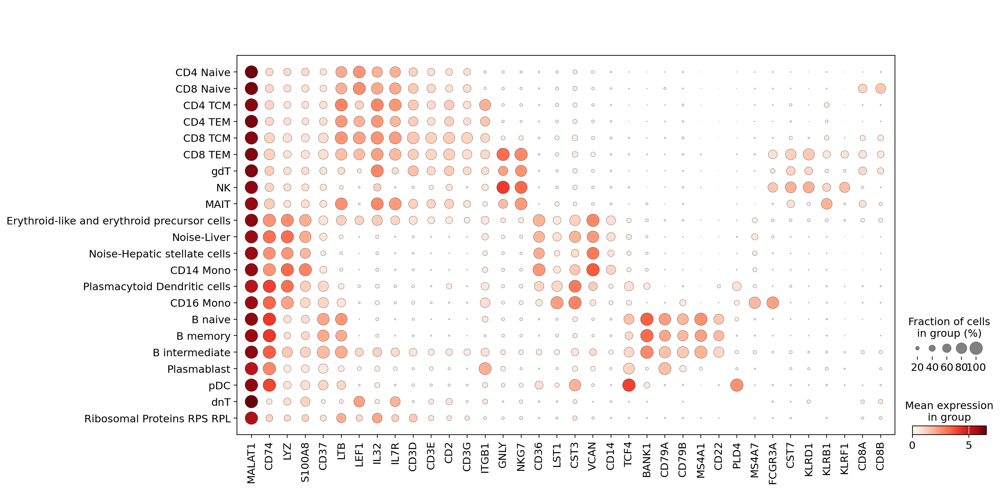

In [ ]:
sc.pl.dotplot(ad_rna, marker_genes, groupby='celltype');

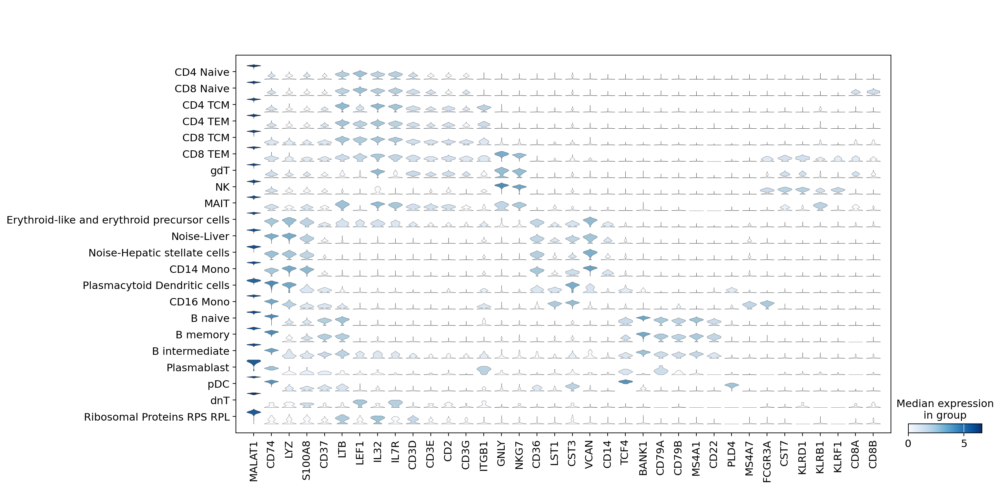

In [ ]:
sc.pl.stacked_violin(ad_rna, marker_genes, groupby='celltype', rotation=90);

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
ad_rna.write(results_file, compression='gzip')  # `compression='gzip'` saves disk space, but slows down writing and subsequent reading

In [ ]:
ad_rna.raw.to_adata().write('./write/pbmc10k_withoutX.h5ad')

In [ ]:
# Export single fields of the annotation of observations
ad_rna.obs[['n_genes', 'celltype']].to_csv('./write/pbmc10k_corrected_leiden.csv')

# Export single columns of the multidimensional annotation
ad_rna.obsm.to_df()[['X_pca1', 'X_pca2']].to_csv('./write/pbmc10k_corrected_X_pca.csv')

# Or export everything except the data using `.write_csvs`.
# Set `skip_data=False` if you also want to export the data.
ad_rna.write_csvs(results_file[:-5], )

In [ ]:
ad_rna.obs.to_csv('./write/pbmc10k_adata_obs.csv')

In [ ]:
#adata # AnnData object with n_obs × n_vars = 11505 × 1654
'''
    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',
    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'
    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'
'''

"\n    obs: 'all_368eqtl_gexdiff0801_0', 'top125_eqtl_0', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'leiden'\n    var: 'gene_ids', 'feature_types', 'genome', 'n_cells', 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts',\n    'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'mean', 'std'\n    uns: 'hvg', 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'top125_eqtl_0_colors', 'umap', 'all_762eqtl_0_colors'\n    obsm: 'X_pca', 'X_umap'\n    varm: 'PCs'\n    obsp: 'connectivities', 'distances'\n"

In [ ]:
mdata.mod['rna'] = ad_rna

In [ ]:
mdata.write('./write/pbmc10k.h5mu')

{'heatmap_ax': <Axes: >, 'groupby_ax': <Axes: xlabel='celltype'>}

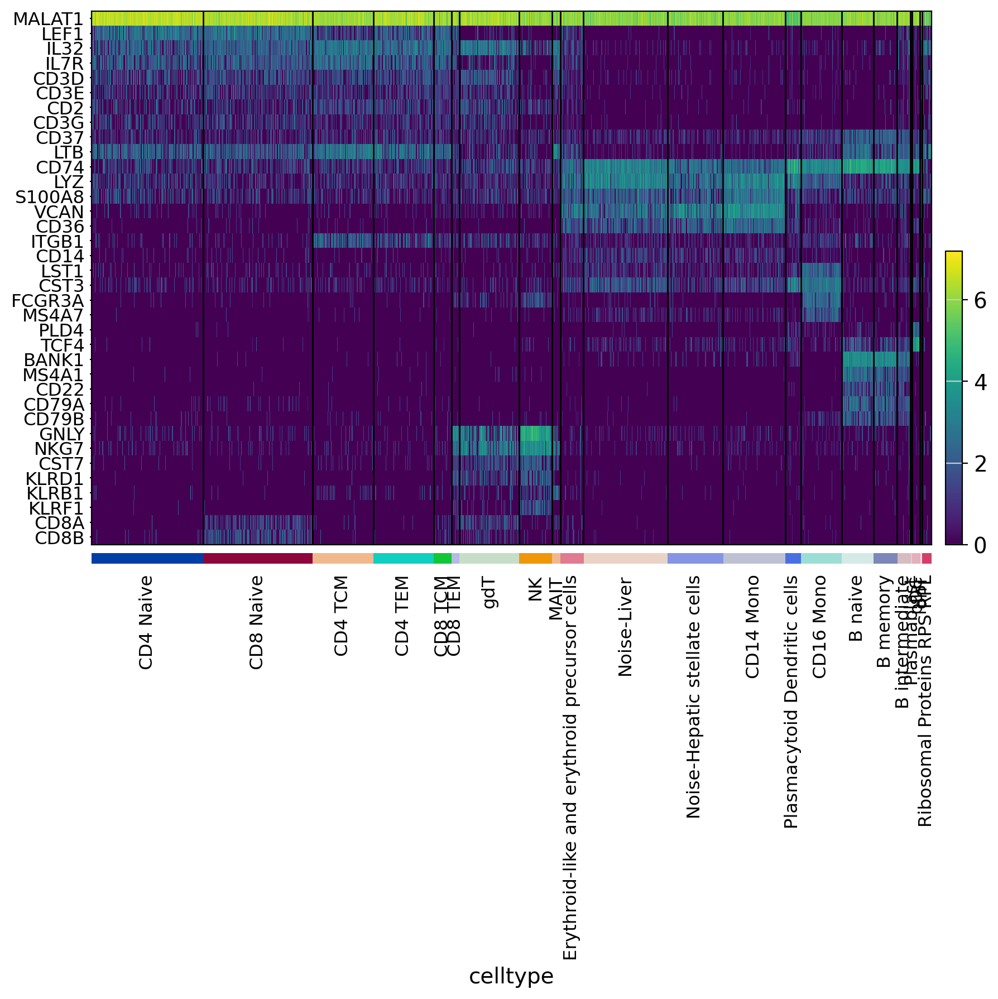

In [ ]:
#markers = [ 'CD79A', 'CD79B', 'CST3', 'LYZ'] #'C1QA', 'PSAP',
markers = [
    'MALAT1',
    'LEF1',
    'IL32',
    'IL7R',
    'CD3D',
    "CD3E",
    "CD2",
    "CD3G",

    'CD37',
    'LTB',
    'CD74',

    'LYZ',
    'S100A8',
    'VCAN',

    'CD36',


    'ITGB1',
    'CD14',

    'LST1',
    'CST3', # Dendritic Cells

    'FCGR3A',
    'MS4A7',

    'PLD4',
    'TCF4',
    'BANK1',
    'MS4A1',
    'CD22',
    'CD79A',
    'CD79B',
    'GNLY',
    'NKG7',
    'CST7',
    'KLRD1',

    'KLRB1',
    'KLRF1',
    'CD8A',
    'CD8B',

    ]

sc.pl.heatmap(ad_rna, markers, groupby='celltype', swap_axes=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_celltype']`
categories: CD4 Naive, CD8 Naive, CD4 TCM, etc.
var_group_labels: 0, 1, 2, etc.


{'heatmap_ax': <Axes: >,
 'groupby_ax': <Axes: ylabel='celltype'>,
 'dendrogram_ax': <Axes: >,
 'gene_groups_ax': <Axes: >}

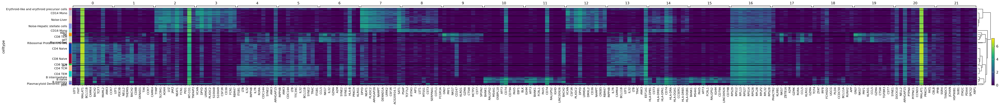

In [ ]:
sc.pl.rank_genes_groups_heatmap(ad_rna, groupby='celltype',show_gene_labels=True)

In [ ]:
mdata

MuData object with n_obs × n_vars = 11898 × 145541
  var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells'
  2 modalities
    rna:	11505 x 1654
      obs:	'all_125eqtl_gexdiff0815_0', 'all_125eqtl_gexdiff0815_1', 'all_125eqtl_gexdiff0815_2', 'all_125eqtl_gexdiff0815_3', 'all_125eqtl_gexdiff0815_4', 'all_125eqtl_gexdiff0815_5', 'all_125eqtl_gexdiff0815_6', 'all_125eqtl_gexdiff0815_7', 'all_125eqtl_gexdiff0815_8', 'all_125eqtl_gexdiff0815_9', 'all_125eqtl_gexdiff0815_10', 'all_125eqtl_gexdiff0815_11', 'all_125eqtl_gexdiff0815_12', 'all_125eqtl_gexdiff0815_13', 'all_125eqtl_gexdiff0815_14', 'all_125eqtl_gexdiff0815_15', 'all_125eqtl_gexdiff0815_16', 'all_125eqtl_gexdiff0815_17', 'all_125eqtl_gexdiff0815_18', 'all_125eqtl_gexdiff0815_19', 'all_125eqtl_gexdiff0815_20', 'all_125eqtl_gexdiff0815_21', 'all_125eqtl_gexdiff0815_22', 'all_125eqtl_gexdiff0815_23', 'all_125eqtl_gexdiff0815_24', 'all_125eqtl_gexdiff0815_25', 'all_125eqtl_gexdiff0815_26', 'all_125eqtl_gexdiff0815_27', 'all_125eqtl_gexdiff0815_28', 'all_125eqtl_gexdiff0815_29', 'all_125eqtl_gexdiff0815_30', 'all_125eqtl_gexdiff0815_31', 'all_125eqtl_gexdiff0815_32', 'all_125eqtl_gexdiff0815_33', 'all_125eqtl_gexdiff0815_34', 'all_125eqtl_gexdiff0815_35', 'all_125eqtl_gexdiff0815_36', 'all_125eqtl_gexdiff0815_37', 'all_125eqtl_gexdiff0815_38', 'all_125eqtl_gexdiff0815_39', 'all_125eqtl_gexdiff0815_40', 'all_125eqtl_gexdiff0815_41', 'all_125eqtl_gexdiff0815_42', 'all_125eqtl_gexdiff0815_43', 'all_125eqtl_gexdiff0815_44', 'all_125eqtl_gexdiff0815_45', 'all_125eqtl_gexdiff0815_46', 'all_125eqtl_gexdiff0815_47', 'all_125eqtl_gexdiff0815_48', 'all_125eqtl_gexdiff0815_49', 'all_125eqtl_gexdiff0815_50', 'all_125eqtl_gexdiff0815_51', 'all_125eqtl_gexdiff0815_52', 'all_125eqtl_gexdiff0815_53', 'all_125eqtl_gexdiff0815_54', 'all_125eqtl_gexdiff0815_55', 'all_125eqtl_gexdiff0815_56', 'all_125eqtl_gexdiff0815_57', 'all_125eqtl_gexdiff0815_58', 'all_125eqtl_gexdiff0815_59', 'all_125eqtl_gexdiff0815_60', 'all_125eqtl_gexdiff0815_61', 'all_125eqtl_gexdiff0815_62', 'all_125eqtl_gexdiff0815_63', 'all_125eqtl_gexdiff0815_64', 'all_125eqtl_gexdiff0815_65', 'all_125eqtl_gexdiff0815_66', 'all_125eqtl_gexdiff0815_67', 'all_125eqtl_gexdiff0815_68', 'all_125eqtl_gexdiff0815_69', 'all_125eqtl_gexdiff0815_70', 'all_125eqtl_gexdiff0815_71', 'all_125eqtl_gexdiff0815_72', 'all_125eqtl_gexdiff0815_73', 'all_125eqtl_gexdiff0815_74', 'all_125eqtl_gexdiff0815_75', 'all_125eqtl_gexdiff0815_76', 'all_125eqtl_gexdiff0815_77', 'all_125eqtl_gexdiff0815_78', 'all_125eqtl_gexdiff0815_79', 'all_125eqtl_gexdiff0815_80', 'all_125eqtl_gexdiff0815_81', 'all_125eqtl_gexdiff0815_82', 'all_125eqtl_gexdiff0815_83', 'all_125eqtl_gexdiff0815_84', 'all_125eqtl_gexdiff0815_85', 'all_125eqtl_gexdiff0815_86', 'all_125eqtl_gexdiff0815_87', 'all_125eqtl_gexdiff0815_88', 'all_125eqtl_gexdiff0815_89', 'all_125eqtl_gexdiff0815_90', 'all_125eqtl_gexdiff0815_91', 'all_125eqtl_gexdiff0815_92', 'all_125eqtl_gexdiff0815_93', 'all_125eqtl_gexdiff0815_94', 'all_125eqtl_gexdiff0815_95', 'all_125eqtl_gexdiff0815_96', 'all_125eqtl_gexdiff0815_97', 'all_125eqtl_gexdiff0815_98', 'all_125eqtl_gexdiff0815_99', 'all_125eqtl_gexdiff0815_100', 'all_125eqtl_gexdiff0815_101', 'all_125eqtl_gexdiff0815_102', 'all_125eqtl_gexdiff0815_103', 'all_125eqtl_gexdiff0815_104', 'all_125eqtl_gexdiff0815_105', 'all_125eqtl_gexdiff0815_106', 'all_125eqtl_gexdiff0815_107', 'all_125eqtl_gexdiff0815_108', 'all_125eqtl_gexdiff0815_109', 'all_125eqtl_gexdiff0815_110', 'all_125eqtl_gexdiff0815_111', 'all_125eqtl_gexdiff0815_112', 'all_125eqtl_gexdiff0815_113', 'all_125eqtl_gexdiff0815_114', 'all_125eqtl_gexdiff0815_115', 'all_125eqtl_gexdiff0815_116', 'all_125eqtl_gexdiff0815_117', 'all_125eqtl_gexdiff0815_118', 'all_125eqtl_gexdiff0815_119', 'all_125eqtl_gexdiff0815_120', 'all_125eqtl_gexdiff0815_121', 'all_125eqtl_gexdiff0815_122', 'all_125eqtl_gexdiff0815_123', 'all_125eqtl_gexdiff0815_124', 'top125_eqtl_0', 'top125_eqtl_1', 'top125_eqtl_2', 'top125_eqtl_3', 

## Plot all Top125 eQTL vs Gene expression vs Annotated Cell Type

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

!pip install jedi

!pip install  scvi-colab
from scvi_colab import install
install()

!pip install muon

#!pip install pysam


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
INFO     scvi-colab: Installing scvi-tools.                                                                        
INFO     scvi-colab: Install successful. Testing import.                                                           


In [ ]:
import os
#import h5py
#import scipy
#import seaborn as sns
import anndata
import numpy as np
import scanpy as sc
import pandas as pd
import muon as mu
from muon import MuData
# Import a module with ATAC-seq-related functions
from muon import atac as ac
#from sklearn.preprocessing import StandardScaler
#from sklearn.preprocessing import MinMaxScaler
import scvi; print(scvi.__version__)
import matplotlib.pyplot as plt
from matplotlib.pyplot import rc_context
sc.set_figure_params(dpi=100, figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2
sc.settings.max_memory=5
sc.settings.autoshow=False
#sc.settings.ScanpyConfig(autoshow=False,max_memory=4)

1.0.3


In [ ]:
#mdata = mu.read("/content/drive/MyDrive/pbmc10k.h5mu") # /content/drive/MyDrive/scEpieQTL/pbmc10k.h5mu #scRNA vs scATAC
mdata = mu.read("/content/write/pbmc10k.h5mu")
mdata

MuData object with n_obs × n_vars = 11898 × 145541
  var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_cells'
  2 modalities
    rna:	11505 x 1654
      obs:	'all_125eqtl_gexdiff0815_0', 'all_125eqtl_gexdiff0815_1', 'all_125eqtl_gexdiff0815_2', 'all_125eqtl_gexdiff0815_3', 'all_125eqtl_gexdiff0815_4', 'all_125eqtl_gexdiff0815_5', 'all_125eqtl_gexdiff0815_6', 'all_125eqtl_gexdiff0815_7', 'all_125eqtl_gexdiff0815_8', 'all_125eqtl_gexdiff0815_9', 'all_125eqtl_gexdiff0815_10', 'all_125eqtl_gexdiff0815_11', 'all_125eqtl_gexdiff0815_12', 'all_125eqtl_gexdiff0815_13', 'all_125eqtl_gexdiff0815_14', 'all_125eqtl_gexdiff0815_15', 'all_125eqtl_gexdiff0815_16', 'all_125eqtl_gexdiff0815_17', 'all_125eqtl_gexdiff0815_18', 'all_125eqtl_gexdiff0815_19', 'all_125eqtl_gexdiff0815_20', 'all_125eqtl_gexdiff0815_21', 'all_125eqtl_gexdiff0815_22', 'all_125eqtl_gexdiff0815_23', 'all_125eqtl_gexdiff0815_24', 'all_125eqtl_gexdiff0815_25', 'all_125eqtl_gexdiff0815_26', 'all_125eqtl_gexdiff0815_27', 'all_125eqtl_gexdiff0815_28', 'all_125eqtl_gexdiff0815_29', 'all_125eqtl_gexdiff0815_30', 'all_125eqtl_gexdiff0815_31', 'all_125eqtl_gexdiff0815_32', 'all_125eqtl_gexdiff0815_33', 'all_125eqtl_gexdiff0815_34', 'all_125eqtl_gexdiff0815_35', 'all_125eqtl_gexdiff0815_36', 'all_125eqtl_gexdiff0815_37', 'all_125eqtl_gexdiff0815_38', 'all_125eqtl_gexdiff0815_39', 'all_125eqtl_gexdiff0815_40', 'all_125eqtl_gexdiff0815_41', 'all_125eqtl_gexdiff0815_42', 'all_125eqtl_gexdiff0815_43', 'all_125eqtl_gexdiff0815_44', 'all_125eqtl_gexdiff0815_45', 'all_125eqtl_gexdiff0815_46', 'all_125eqtl_gexdiff0815_47', 'all_125eqtl_gexdiff0815_48', 'all_125eqtl_gexdiff0815_49', 'all_125eqtl_gexdiff0815_50', 'all_125eqtl_gexdiff0815_51', 'all_125eqtl_gexdiff0815_52', 'all_125eqtl_gexdiff0815_53', 'all_125eqtl_gexdiff0815_54', 'all_125eqtl_gexdiff0815_55', 'all_125eqtl_gexdiff0815_56', 'all_125eqtl_gexdiff0815_57', 'all_125eqtl_gexdiff0815_58', 'all_125eqtl_gexdiff0815_59', 'all_125eqtl_gexdiff0815_60', 'all_125eqtl_gexdiff0815_61', 'all_125eqtl_gexdiff0815_62', 'all_125eqtl_gexdiff0815_63', 'all_125eqtl_gexdiff0815_64', 'all_125eqtl_gexdiff0815_65', 'all_125eqtl_gexdiff0815_66', 'all_125eqtl_gexdiff0815_67', 'all_125eqtl_gexdiff0815_68', 'all_125eqtl_gexdiff0815_69', 'all_125eqtl_gexdiff0815_70', 'all_125eqtl_gexdiff0815_71', 'all_125eqtl_gexdiff0815_72', 'all_125eqtl_gexdiff0815_73', 'all_125eqtl_gexdiff0815_74', 'all_125eqtl_gexdiff0815_75', 'all_125eqtl_gexdiff0815_76', 'all_125eqtl_gexdiff0815_77', 'all_125eqtl_gexdiff0815_78', 'all_125eqtl_gexdiff0815_79', 'all_125eqtl_gexdiff0815_80', 'all_125eqtl_gexdiff0815_81', 'all_125eqtl_gexdiff0815_82', 'all_125eqtl_gexdiff0815_83', 'all_125eqtl_gexdiff0815_84', 'all_125eqtl_gexdiff0815_85', 'all_125eqtl_gexdiff0815_86', 'all_125eqtl_gexdiff0815_87', 'all_125eqtl_gexdiff0815_88', 'all_125eqtl_gexdiff0815_89', 'all_125eqtl_gexdiff0815_90', 'all_125eqtl_gexdiff0815_91', 'all_125eqtl_gexdiff0815_92', 'all_125eqtl_gexdiff0815_93', 'all_125eqtl_gexdiff0815_94', 'all_125eqtl_gexdiff0815_95', 'all_125eqtl_gexdiff0815_96', 'all_125eqtl_gexdiff0815_97', 'all_125eqtl_gexdiff0815_98', 'all_125eqtl_gexdiff0815_99', 'all_125eqtl_gexdiff0815_100', 'all_125eqtl_gexdiff0815_101', 'all_125eqtl_gexdiff0815_102', 'all_125eqtl_gexdiff0815_103', 'all_125eqtl_gexdiff0815_104', 'all_125eqtl_gexdiff0815_105', 'all_125eqtl_gexdiff0815_106', 'all_125eqtl_gexdiff0815_107', 'all_125eqtl_gexdiff0815_108', 'all_125eqtl_gexdiff0815_109', 'all_125eqtl_gexdiff0815_110', 'all_125eqtl_gexdiff0815_111', 'all_125eqtl_gexdiff0815_112', 'all_125eqtl_gexdiff0815_113', 'all_125eqtl_gexdiff0815_114', 'all_125eqtl_gexdiff0815_115', 'all_125eqtl_gexdiff0815_116', 'all_125eqtl_gexdiff0815_117', 'all_125eqtl_gexdiff0815_118', 'all_125eqtl_gexdiff0815_119', 'all_125eqtl_gexdiff0815_120', 'all_125eqtl_gexdiff0815_121', 'all_125eqtl_gexdiff0815_122', 'all_125eqtl_gexdiff0815_123', 'all_125eqtl_gexdiff0815_124', 'top125_eqtl_0', 'top125_eqtl_1', 'top125_eqtl_2', 'top125_eqtl_3', 

In [ ]:
#ad_rna = mdata.mod['rna']
#new_adata = mdata.mod['cello']
#atac = mdata.mod['atac']

## 讀入Gene ID

In [ ]:
all762eqtl_ID=np.load('/content/drive/MyDrive/scEpieQTL/all762eqtl_ID.npy') #沒有附gene的eQTL
all762eqtl_geneID=np.load('/content/drive/MyDrive/scEpieQTL/786_peak_id_gene_name.npy') #有附gene的eQTL
eqtl125_geneID0815=np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_newmodelgexdiff0815ID.npy') #0815找出的125個eQTL

In [ ]:
#計算標準差
all125eqtl_gexdiff = pd.DataFrame(np.load('/content/drive/MyDrive/scEpieQTL/all_125eqtl_atacnewgrouping_newmodelgexdiff0815.npy'))
all125eqtl_gexdiff_std = all125eqtl_gexdiff.T.describe().loc['std']

In [ ]:
dfsb=pd.read_pickle('/content/drive/MyDrive/scEpieQTL/whole_blood_eqtl_.scbasset.seqs_762.pandas.pickle')
sb1572_index=dfsb.index.to_numpy()

sb786_index = np.empty(len(sb1572_index)//2, dtype=sb1572_index.dtype)
for i in range(0,1572):
  k=i//2
  sb786_index[k]=sb1572_index[i]
  i+=1

Peak762_index = np.array([item.split('_', 1)[1] for item in sb786_index])

In [ ]:
data_frame = pd.read_csv('/content/drive/MyDrive/scEpieQTL/125_eqtl_cell_gmm_cluster_labels_0803.csv')

data_frame.drop('Unnamed: 0', axis=1, inplace=True)

# 将行和列交换，使用transpose()方法
data_frame_transposed = data_frame.transpose()

# 将DataFrame转换为NumPy数组
#data_array = data_frame_transposed.to_numpy()

top125_eqtl_ID=data_frame_transposed.index.to_numpy()

In [ ]:
n_clusters = 6
n_colors = plt.cm.jet(np.linspace(0.9,0.1,n_clusters))

import matplotlib.colors as mcolors
#mcolors.is_color_like(n_colors[4])
n_colors_str = [mcolors.to_hex(color) for color in n_colors]


In [ ]:
palettes={
     0: n_colors_str[0],
     1: n_colors_str[1],
     2: n_colors_str[2],
     3: n_colors_str[3],
     4: n_colors_str[4],
     5: n_colors_str[5],
     "Noise-Liver" : '#bec1d4',
     "Noise-Hepatic stellate cells" :  '#e6afb9',
     'Erythroid-like and erythroid precursor cells' : '#11c638',
     'Plasmacytoid Dendritic cells' : '#c6dec7',
     'Ribosomal Proteins RPS RPL' :  '#f0b98d',
     'helper T cell' :  '#c5b0d5',
     'T follicular helper cell' :  '#d62728',
     'CD14-positive, CD16-negative classical monocyte' : '#1f77b4',
     'central memory CD8-positive, alpha-beta T cell' : '#ff7f0e',
     'naive thymus-derived CD4-positive, alpha-beta T cell' : '#279e68',
     'naive thymus-derived CD8-positive, alpha-beta T cell' : '#d62728',
     'CD4-positive, alpha-beta memory T cell' : '#aa40fc',
     'mononuclear cell' : '#8c564b',
     'memory T cell' : '#e377c2',
     'professional antigen presenting cell' : '#b5bd61',
     'class switched memory B cell' : '#17becf',
     'natural killer cell' : '#aec7e8',
     'naive B cell' : '#ffbb78',
     'myeloid leukocyte' : '#98df8a',
     'T cell' : '#ff9896',
     'innate effector T cell' : '#c5b0d5',
     'CD4-positive, CD25-positive, alpha-beta regulatory T cell' : '#c49c94',
     'common myeloid progenitor' : '#f7b6d2',
     'memory B cell' : '#dbdb8d',
     'CD4 Naive' : '#023fa5',
     'CD4 TCM' : '#7d87b9',
     'CD4 CTL' : '#bec1d4',
     'CD4 TEM' : '#d6bcc0',
     'CD4 Proliferating' : '#bb7784',
     'CD8 Naive' : '#8e063b',
     'dnT' : '#4a6fe3',
     'CD8 TEM' : '#8595e1',
     'CD8 TCM' : '#b5bbe3',
     'CD8 Proliferating' : '#e6afb9',
     'MAIT' : '#e07b91',
     'NK' : '#d33f6a',
     'cDC2' : '#11c638',
     'NK Proliferating' : '#8dd593',
     'gdT' : '#c6dec7',
     'pDC' : '#ead3c6',
     'B naive' : '#f0b98d',
     'B intermediate' : '#ef9708',
     'B memory' : '#0fcfc0',
     'Plasmablast' : '#9cded6',
     'CD14 Mono' : '#d5eae7',
     'CD16 Mono' : '#f3e1eb',
     'intermediate mono'	:	 '#8000ff',
     'CD4+ memory T'	:	 '#5641fd',
     'CD8+ naïve T'	:	 '#2c7ef7',
     'CD4+ naïve T'	:	 '#00b5eb',
     'CD14 mono'	:	 '#2adddd',
     'CD8+ activated T'	:	 '#54f6cb',
     'memory B'	:	 '#80ffb4',
     'CD16 mono'	:	 '#abf69b',
     'NK'	:	 '#d4dd80',
     'naïve B'	:	 '#ffb360',
     'mDC'	:	 '#ff7e41',
     'MAIT'	:	 '#ff4121',
     'pDC'	:	 '#ff0000',
     }

In [ ]:
def PlotPDF(file_name,start,end):
  import matplotlib
  matplotlib.use('agg')
  import matplotlib.pyplot as plt # matplotlib.use('agg')必须在本句执行前运行
  from matplotlib.backends.backend_pdf import PdfPages

  pdf_file = file_name  # PDF 檔案名稱

  # 建立一個 PDF 物件
  pdf_pages = PdfPages(pdf_file)

  for j in range(start,end): #
      for i in range(len(all762eqtl_ID)):       #range(len(all_762eqtl_ID))：起始值從0開始，所以會執行0到785(共786次)，但只會找出有在eqtl368_gene中的368個列印出來。
         if all762eqtl_ID[i] == top125_eqtl_ID[j]:
          for k in range(len(eqtl125_geneID0815)):
            if eqtl125_geneID0815[k] == all762eqtl_geneID[i]:
              fig = sc.pl.umap(
                  mdata.mod['rna'], #ad_rna, #adata
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all_125eqtl_gexdiff0815_{k:d}",'celltype'], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl125_geneID0815[k],'scRNA Cell Type'],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all125eqtl_gexdiff_std[k],
                  vmax = 3*all125eqtl_gexdiff_std[k],
                  vcenter = 0,
                  #legend_loc='on data',legend_fontsize=12, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,


              )
              '''
              fig1 = sc.pl.umap(
                  mdata.mod['cello'], #new_adata, #adata
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all_125eqtl_gexdiff0815_{k:d}",'Most specific cell type'], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl125_geneID0815[k],'CellO Cell Type'],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all125eqtl_gexdiff_std[k],
                  vmax = 3*all125eqtl_gexdiff_std[k],
                  vcenter = 0,
                  legend_loc='on data',legend_fontsize=12, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,


              )

              fig2 = sc.pl.umap(
                  mdata.mod['atac'],#atac,
                  color=[f"top125_eqtl_{j:d}",f"Peak762_{i:d}",f"all_125eqtl_gexdiff0815_{k:d}",'celltype',], # 'leiden'
                  title=[all762eqtl_geneID[i],Peak762_index[i],eqtl125_geneID0815[k],'scATAC Cell Type',],#'Cell Type"
                  frameon=False,
                  return_fig=True,
                  colorbar_loc = 'right',
                  color_map= 'RdBu_r',  #'jet',
                  vmin = -3*all125eqtl_gexdiff_std[k],
                  vmax = 3*all125eqtl_gexdiff_std[k],
                  vcenter = 0,
                  legend_loc='on data',legend_fontsize=12, legend_fontoutline=1,
                  #palette = n_colors_str, #'jet' #cm.jet(np.linspace(0.1,0.9,5))
                  palette=palettes,

              ) # save='CellType.pdf') # legend_fontsize="xx-small"
              '''
              pdf_pages.savefig(fig, bbox_inches="tight")
              #pdf_pages.savefig(fig1, bbox_inches="tight")
              #pdf_pages.savefig(fig2, bbox_inches="tight")
  # 關閉 PDF 物件
  pdf_pages.close()

In [ ]:
PlotPDF('Top125_eqtl_0821scRNA-1.pdf',0,25)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

In [ ]:
PlotPDF('Top125_eqtl_0821scRNA-2.pdf',25,50)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

In [ ]:
PlotPDF('Top125_eqtl_0821scRNA-3.pdf',50,75)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

In [ ]:
PlotPDF('Top125_eqtl_0821scRNA-4.pdf',75,100)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

In [ ]:
PlotPDF('Top125_eqtl_0821scRNA-5.pdf',100,125)

/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/usr/local/lib/python3.10/dist-packages/scanp

In [ ]:
#執行gs來合併或壓縮pdf檔

In [ ]:
!apt-get install ghostscript

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  fonts-droid-fallback fonts-noto-mono fonts-urw-base35 libgs9 libgs9-common
  libidn12 libijs-0.35 libjbig2dec0 poppler-data
Suggested packages:
  fonts-noto fonts-freefont-otf | fonts-freefont-ttf fonts-texgyre
  ghostscript-x poppler-utils fonts-japanese-mincho | fonts-ipafont-mincho
  fonts-japanese-gothic | fonts-ipafont-gothic fonts-arphic-ukai
  fonts-arphic-uming fonts-nanum
The following NEW packages will be installed:
  fonts-droid-fallback fonts-noto-mono fonts-urw-base35 ghostscript libgs9
  libgs9-common libidn12 libijs-0.35 libjbig2dec0 poppler-data
0 upgraded, 10 newly installed, 0 to remove and 16 not upgraded.
Need to get 16.7 MB of archives.
After this operation, 63.0 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu jammy/main amd64 fonts-droid-fallback all 1:6.0.1r16-1.1build1 [1,805 kB]


In [ ]:
import shutil
gs_path = shutil.which('gs')

In [ ]:
import os
import subprocess

def merge_pdfs(folder_path, output_file):
    pdf_files = [file for file in os.listdir(folder_path) if file.endswith('.pdf')]
    pdf_files.sort()  # 确保文件按名称排序

    # 构建Ghostscript命令
    gs_command = [gs_path, '-dBATCH', '-dNOPAUSE', '-q', '-sDEVICE=pdfwrite', '-sOutputFile=' + output_file]

    # 添加所有PDF文件到命令
    for pdf_file in pdf_files:
        gs_command.append(os.path.join(folder_path, pdf_file))

    # 调用Ghostscript执行PDF合并
    subprocess.run(gs_command)

# 设置文件夹路径和输出文件名
folder_path = '/content'  # 替换为实际的文件夹路径
output_file = '/content/output_0821.pdf'  # 替换为实际的输出文件路径和名称

# 调用函数进行PDF合并
merge_pdfs(folder_path, output_file)
